In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pprint
sns.set(style="white", context='poster')
import math
from scipy.integrate import solve_ivp

In [2]:
%load_ext autoreload
%autoreload 2


In [3]:
#from model_equations_separate_NC import *
from model_equations_separate_NC_store_numba import *


In [4]:
morder = ['MIN', 'OVERFLOW', 'MIXOTROPH', 'EXOENZYME', 'ROS',]
media_order = ['lowN', 'pro99']
mpalette = 'twilight'
sns.color_palette(mpalette, n_colors=5)


[(0.4828677867260272, 0.6304330455306234, 0.761915371498953),
 (0.3668108554010799, 0.26404857724525643, 0.6464799165290824),
 (0.18488035509396164, 0.07942573027972388, 0.21307651648984993),
 (0.5566322903496934, 0.17269677158182117, 0.31423043195101424),
 (0.775907907306857, 0.5355421788246119, 0.42413367909988375)]

In [5]:

HCOLOR = '#ffc58f'
HCOLOR_light = '#ffd2a9'
PCOLOR = '#99cc99'
PCOLOR_light = '#aad5aa'

DONCOLOR = '#7285b7'
RDONCOLOR = 'black' #'#00334D'
DINCOLOR = '#bbdaff' #'#000066'

DOCCOLOR = '#cc6666'
RDOCCOLOR = 'black' #'#00334D'
DICCOLOR = '#ff9da4' #'#000066'

SHCOLOR = '#ffa98f'
SPCOLOR = '#326232'


ccnpalette = [PCOLOR, PCOLOR_light, HCOLOR, HCOLOR_light, SPCOLOR, SHCOLOR,DONCOLOR, RDONCOLOR, DINCOLOR]
ccnorder = ['Bp', 'Np', 'Bh','Nh',  'ABp', 'ABh', 'DON', 'RDON', 'DIN', ]
cccpalette = [PCOLOR, PCOLOR_light, HCOLOR, HCOLOR_light, SPCOLOR, SHCOLOR, DOCCOLOR, RDOCCOLOR, DICCOLOR]
cccorder = ['Bp[C]', 'Cp', 'Bh[C]', 'Ch', 'ABp[C]', 'ABh[C]', 'DOC', 'RDOC', 'DIC']
ccxpalette = [PCOLOR, HCOLOR]
ccxorder = ['Xp', 'Xh']
hnpalette = [ HCOLOR_light, SPCOLOR, SHCOLOR, DONCOLOR, RDONCOLOR, DINCOLOR]
hnorder = [ 'Bh', 'ABp', 'ABh', 'DON', 'RDON', 'DIN']
hcpalette = [ HCOLOR_light, SPCOLOR, SHCOLOR, DOCCOLOR, RDOCCOLOR, DICCOLOR]
hcorder = [ 'Bh[C]', 'ABp[C]', 'ABh[C]', 'DOC', 'RDOC', 'DIC']
pnpalette = [ PCOLOR_light, SPCOLOR, SHCOLOR, DONCOLOR, RDONCOLOR, DINCOLOR]
pnorder = [ 'Bp', 'ABp', 'ABh', 'DON', 'RDON', 'DIN']
pcpalette = [ PCOLOR_light, SPCOLOR, SHCOLOR, DOCCOLOR, RDOCCOLOR, DICCOLOR]
pcorder = [ 'Bp[C]', 'ABp[C]', 'ABh[C]', 'DOC', 'RDOC', 'DIC']
sns.color_palette(ccnpalette + cccpalette, )
# 


[(0.6, 0.8, 0.6),
 (0.6666666666666666, 0.8352941176470589, 0.6666666666666666),
 (1.0, 0.7725490196078432, 0.5607843137254902),
 (1.0, 0.8235294117647058, 0.6627450980392157),
 (0.19607843137254902, 0.3843137254901961, 0.19607843137254902),
 (1.0, 0.6627450980392157, 0.5607843137254902),
 (0.4470588235294118, 0.5215686274509804, 0.7176470588235294),
 (0.0, 0.0, 0.0),
 (0.7333333333333333, 0.8549019607843137, 1.0),
 (0.6, 0.8, 0.6),
 (0.6666666666666666, 0.8352941176470589, 0.6666666666666666),
 (1.0, 0.7725490196078432, 0.5607843137254902),
 (1.0, 0.8235294117647058, 0.6627450980392157),
 (0.19607843137254902, 0.3843137254901961, 0.19607843137254902),
 (1.0, 0.6627450980392157, 0.5607843137254902),
 (0.8, 0.4, 0.4),
 (0.0, 0.0, 0.0),
 (1.0, 0.615686274509804, 0.6431372549019608)]

In [6]:

 
sns.color_palette([PCOLOR, HCOLOR, PCOLOR_light, HCOLOR_light] )


[(0.6, 0.8, 0.6),
 (1.0, 0.7725490196078432, 0.5607843137254902),
 (0.6666666666666666, 0.8352941176470589, 0.6666666666666666),
 (1.0, 0.8235294117647058, 0.6627450980392157)]

In [7]:
refdf = pd.read_excel('reference_10cc.xlsx')

In [8]:
dpath = '/fast_data/Osnat/RECYCLE_MODEL/results/shgo2/out'
dpath = 'results'

In [9]:
os.listdir(dpath)

['monte3_ROS_df.csv.gz',
 'loss_analysis',
 'monte3_MIN_df.csv.gz',
 'monte_sum.csv.gz',
 'monte3_ROS_mse.csv.gz',
 'monte_df.csv.gz',
 'monte3_ROS_sum.csv.gz',
 'sobol_ponly4_mse.csv.gz',
 'vpro_ponly_mse.csv.gz',
 'monte3_OVERFLOW_sum.csv.gz',
 'monte3_MIXOTROPH_sum.csv.gz',
 'monte_mse.csv.gz',
 'monte3_EXOENZYME_sum.csv.gz',
 'monte3_EXOENZYME_df.csv.gz',
 'vpro_ponly_df.csv.gz',
 'monte3_MIN_mse.csv.gz',
 'sobol_ponly4_sum.csv.gz',
 'monte3_OVERFLOW_mse.csv.gz',
 'sobol_ponly3_mse.csv.gz',
 'monte3_EXOENZYME_mse.csv.gz',
 'vpro_ponly_sum.csv.gz',
 'sobol_ponly3_df.csv.gz',
 'sobol_ponly3_sum.csv.gz',
 'monte3_MIN_sum.csv.gz',
 'monte3_OVERFLOW_df.csv.gz',
 'monte3_MIXOTROPH_df.csv.gz',
 'sobol_ponly4_df.csv.gz',
 'monte3_MIXOTROPH_mse.csv.gz']

In [10]:
pro99_mode = False 
which_organism = 'all'
organism_to_tune = 'HET'
(var_names, init_var_vals, intermediate_names, calc_dydt, prepare_params_tuple
) = get_constants_per_organism(pro99_mode, which_organism)
    


In [11]:
df = pd.concat([pd.read_csv(os.path.join(dpath,f'monte3_{m}_df.csv.gz')) for m in morder], ignore_index=True)
mse_df = pd.concat([pd.read_csv(os.path.join(dpath,f'monte3_{m}_mse.csv.gz')) for m in morder], ignore_index=True)
sum_df = pd.concat([pd.read_csv(os.path.join(dpath,f'monte3_{m}_sum.csv.gz')) for m in morder], ignore_index=True)

From https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.least_squares.html

* ‘linear’ (default) : rho(z) = z. Gives a standard least-squares problem.

* ‘soft_l1’ : rho(z) = 2 * ((1 + z)**0.5 - 1). The smooth approximation of l1 (absolute value) loss. Usually a good choice for robust least squares.

* ‘huber’ : rho(z) = z if z <= 1 else 2*z**0.5 - 1. Works similarly to ‘soft_l1’.

*  ‘cauchy’ : rho(z) = ln(1 + z). Severely weakens outliers influence, but may cause difficulties in optimization process.

* ‘arctan’ : rho(z) = arctan(z). Limits a maximum loss on a single residual, has properties similar to ‘cauchy’

In [12]:
sum_df[['idx', 'media', 'which', 'model', 'hash']] = sum_df.run_id.str.rsplit('_', n=4, expand=True)
mse_df[['idx', 'media', 'which', 'model', 'hash']] = mse_df.run_id.str.rsplit('_', n=4, expand=True)
df    [['idx', 'media', 'which', 'model', 'hash']] =     df.run_id.str.rsplit('_', n=4, expand=True)



In [13]:
sum_df['vpro'] = sum_df.idx.str.extract(r'(vpro_\d+_[A-Z]+)', expand=True)
mse_df['vpro'] = mse_df.idx.str.extract(r'(vpro_\d+_[A-Z]+)', expand=True)
df    ['vpro'] =     df.idx.str.extract(r'(vpro_\d+_[A-Z]+)', expand=True)


In [14]:
sum_df.idx.head().unique()

array(['monte3_MIN_77_monte_shgo3_sobol_245_MIN_62',
       'monte3_MIN_11_monte_shgo4_sobol_518_MIN_8',
       'monte3_MIN_25_monte_shgo3_sobol_665_MIN_9',
       'monte3_MIN_10_monte_shgo3_sobol_37_MIN_0',
       'monte3_MIN_86_monte_shgo3_sobol_566_MIN_38'], dtype=object)

In [15]:
mse_df = mse_df.loc[~mse_df.Group.isin(['Axenic'])]

In [16]:
mse_df.groupby('media').compare_points.describe()

,count,mean,std,min,25%,50%,75%,max
media,,,,,,,,
lowN,1033209.0,73.826587,2.088019,3.0,74.0,74.0,74.0,74.0


In [17]:
mse_df['ref_compare_points'] = mse_df.media.map({'lowN' : 74, 'pro99': 58})
bad_ids_missing_points = set(mse_df.loc[mse_df.ref_compare_points != mse_df.compare_points, 'idx' ])
len(bad_ids_missing_points)

994

In [18]:
min_values = df[var_names+ ['idx']].groupby('idx').min().min(axis=1)
bad_ids_negative_values = set(min_values[min_values< -1e-9].index)
len(bad_ids_negative_values)

1979

In [19]:
bad_ids = bad_ids_missing_points | bad_ids_negative_values
len(bad_ids)

2268

In [20]:
mse_df = mse_df.loc[~mse_df.idx.isin(bad_ids)].copy()
sum_df = sum_df.loc[~sum_df.idx.isin(bad_ids)].copy()
df     =     df.loc[    ~df.idx.isin(bad_ids)].copy()


In [21]:
refdf = refdf.loc[~refdf.Group.isin(['Axenic'])]

In [13]:
os.listdir(os.path.join(dpath, 'loss_analysis'))

['loss_monte3_ROS_cauchy_0.1_loss_cauchy_0.1.csv.gz',
 'loss_monte3_OVERFLOW_huber_0.01_loss_huber_0.01.csv.gz',
 'loss_monte3_MIXOTROPH_softl1_100_loss_softl1_100.0.csv.gz',
 'loss_monte3_MIXOTROPH_cauchy_0.1_loss_cauchy_0.1.csv.gz',
 'loss_monte3_EXOENZYME_arctan_1_loss_arctan_1.0.csv.gz',
 'loss_monte3_MIN_softl1_0.1_loss_softl1_0.1.csv.gz',
 'loss_monte3_ROS_huber_1_loss_huber_1.0.csv.gz',
 'loss_monte3_OVERFLOW_softl1_0.01_loss_softl1_0.01.csv.gz',
 'loss_monte3_MIN_arctan_0.1_loss_arctan_0.1.csv.gz',
 'loss_monte3_EXOENZYME_softl1_1_loss_softl1_1.0.csv.gz',
 'loss_monte3_OVERFLOW_huber_10_loss_huber_10.0.csv.gz',
 'loss_monte3_MIXOTROPH_softl1_1_loss_softl1_1.0.csv.gz',
 'loss_monte3_ROS_softl1_10_loss_softl1_10.0.csv.gz',
 'loss_monte3_OVERFLOW_linear_1_loss_linear_1.0.csv.gz',
 'loss_monte3_MIN_huber_10_loss_huber_10.0.csv.gz',
 'loss_monte3_EXOENZYME_cauchy_100_loss_cauchy_100.0.csv.gz',
 'loss_monte3_ROS_arctan_1_loss_arctan_1.0.csv.gz',
 'loss_monte3_ROS_cauchy_0.01_loss_cau

In [16]:
pd.read_csv(os.path.join(dpath, 'loss_analysis','loss_monte3_ROS_cauchy_0.1_loss_cauchy_0.1.csv.gz',)).columns

Index(['run_id', 'level_1', 'Sample', 'full name', 'Group',
       'cauchy_0.1_Bptotal[N]', 'cauchy_0.1_Bptotal[C]', 'cauchy_0.1',
       'compare_points'],
      dtype='object')

In [32]:
def _get_loss_df(fname):
    id_vars = ['run_id',  'Sample', 'full name', 'Group', 'compare_points']
    d = pd.read_csv(os.path.join(dpath, 'loss_analysis',fname))
    value_vars = [c for c in d.columns if not(c in id_vars + ['level_1']) and not ('Bptotal' in c)]
    d = d.loc[~d.Group.isin(['Axenic'])]
    d = d.melt(id_vars=id_vars, value_vars=value_vars, value_name='loss_value', var_name='loss_param')
    return d
    
    
loss_df = pd.concat(
    [_get_loss_df(fname) for fname in os.listdir(os.path.join(dpath, 'loss_analysis'))],
     ignore_index=True,
)

In [33]:
loss_df

,run_id,Sample,full name,Group,compare_points,loss_param,loss_value
0,monte3_ROS_100_monte_shgo3_sobol_107_ROS_77_lo...,10A0,Marinovum 5F3,Weak,74.0,cauchy_0.1,1.586175
1,monte3_ROS_100_monte_shgo3_sobol_107_ROS_77_lo...,10B0,Marinovum 5F3,Weak,74.0,cauchy_0.1,1.601139
2,monte3_ROS_100_monte_shgo3_sobol_107_ROS_77_lo...,10C0,Marinovum 5F3,Weak,74.0,cauchy_0.1,1.610867
3,monte3_ROS_100_monte_shgo3_sobol_107_ROS_77_lo...,11A0,Roseovarius 5C3,Weak,74.0,cauchy_0.1,1.594254
4,monte3_ROS_100_monte_shgo3_sobol_107_ROS_77_lo...,11B0,Roseovarius 5C3,Weak,74.0,cauchy_0.1,1.636302
...,...,...,...,...,...,...,...
24494395,monte3_MIXOTROPH_9_monte_shgo4_sobol_995_MIXOT...,7B0,Sulfitobacter pseudonitzschiae,Sustained,74.0,arctan_0.1,0.406923
24494396,monte3_MIXOTROPH_9_monte_shgo4_sobol_995_MIXOT...,7C0,Sulfitobacter pseudonitzschiae,Sustained,74.0,arctan_0.1,0.435473
24494397,monte3_MIXOTROPH_9_monte_shgo4_sobol_995_MIXOT...,9A0,E. coli,Weak,74.0,arctan_0.1,0.269057
24494398,monte3_MIXOTROPH_9_monte_shgo4_sobol_995_MIXOT...,9B0,E. coli,Weak,74.0,arctan_0.1,0.269575


In [53]:
loss_df['model'] = loss_df.run_id.str.rsplit('_', n=4, expand=True)[3]


In [54]:
loss_df.model.unique()

array(['ROS', 'OVERFLOW', 'MIXOTROPH', 'EXOENZYME', 'MIN'], dtype=object)

From https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.least_squares.html

* ‘linear’ (default) : rho(z) = z. Gives a standard least-squares problem.

* ‘soft_l1’ : rho(z) = 2 * ((1 + z)**0.5 - 1). The smooth approximation of l1 (absolute value) loss. Usually a good choice for robust least squares.

* ‘huber’ : rho(z) = z if z <= 1 else 2*z**0.5 - 1. Works similarly to ‘soft_l1’.

*  ‘cauchy’ : rho(z) = ln(1 + z). Severely weakens outliers influence, but may cause difficulties in optimization process.

* ‘arctan’ : rho(z) = arctan(z). Limits a maximum loss on a single residual, has properties similar to ‘cauchy’

Value of soft margin between inlier and outlier residuals, default is 1.0. The loss function is evaluated as follows rho_(f**2) = C**2 * rho(f**2 / C**2), where C is f_scale, and rho is determined by loss parameter. This parameter has no effect with loss='linear', but for other loss values it is of crucial importance.

In [38]:
loss_df[['loss', 'f_scale']] =  loss_df.loss_param.str.split('_', expand=True)

In [39]:
loss_df_df.columns

Index(['run_id', 'Sample', 'full name', 'Group', 'compare_points',
       'loss_param', 'loss_value', 'model', 'loss', 'f_scale'],
      dtype='object')

In [42]:
mmse_df = mse_df.melt(
    id_vars=['run_id', 'Sample', 'full name', 'Group', 'compare_points','model'],
    value_vars=['RMSE', 'lRMSE',], 
    var_name='loss_param', value_name='loss_value'
)

In [43]:
mmse_df['loss'] =  mmse_df['loss_param']
mmse_df['f_scale'] =  1


In [55]:
floss_df = pd.concat([loss_df, mmse_df], ignore_index=True)

In [56]:
mean_scores = floss_df.loc[floss_df.groupby(['run_id', 'Group', 'loss_param']).loss_value.idxmin()].reset_index(drop=True)


In [57]:
mean_scores['lrank'] = mean_scores.groupby(['loss_param', 'Group', 'model'])["loss_value"].rank(method='first')

In [58]:
mean_scores

,run_id,Sample,full name,Group,compare_points,loss_param,loss_value,model,loss,f_scale,lrank
0,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,3B0,Marinobacter adhaerens HP15,Inhibited,74.0,RMSE,1406.913912,EXOENZYME,RMSE,1,5957.0
1,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,3A0,Marinobacter adhaerens HP15,Inhibited,74.0,arctan_0.01,0.003096,EXOENZYME,arctan,0.01,6638.0
2,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,3A0,Marinobacter adhaerens HP15,Inhibited,74.0,arctan_0.1,0.306578,EXOENZYME,arctan,0.1,6519.0
3,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,4A0,Phaeobacter gallaeciensis,Inhibited,74.0,arctan_1.0,27.163920,EXOENZYME,arctan,1.0,6271.0
4,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,4A0,Phaeobacter gallaeciensis,Inhibited,74.0,arctan_10.0,1302.518549,EXOENZYME,arctan,10.0,6156.0
...,...,...,...,...,...,...,...,...,...,...,...
3916787,monte3_ROS_99_monte_shgo4_sobol_928_ROS_56_low...,9C0,E. coli,Weak,74.0,softl1_0.01,43.940379,ROS,softl1,0.01,4792.0
3916788,monte3_ROS_99_monte_shgo4_sobol_928_ROS_56_low...,9C0,E. coli,Weak,74.0,softl1_0.1,438.445144,ROS,softl1,0.1,4792.0
3916789,monte3_ROS_99_monte_shgo4_sobol_928_ROS_56_low...,9C0,E. coli,Weak,74.0,softl1_1.0,4295.978102,ROS,softl1,1.0,4792.0
3916790,monte3_ROS_99_monte_shgo4_sobol_928_ROS_56_low...,9C0,E. coli,Weak,74.0,softl1_10.0,36574.805139,ROS,softl1,10.0,4793.0


In [73]:
mrows = mean_scores.loc[mean_scores.lrank.le(20)] #& mean_scores.loss.isin([method])]
mrows


,run_id,Sample,full name,Group,compare_points,loss_param,loss_value,model,loss,f_scale,lrank
19025,monte3_EXOENZYME_10_monte_shgo4_sobol_479_EXOE...,5A0,Pseudoalteromonas haloplanktis,Strong,74.0,cauchy_0.01,0.035634,EXOENZYME,cauchy,0.01,20.0
19208,monte3_EXOENZYME_10_monte_shgo4_sobol_519_EXOE...,3C0,Marinobacter adhaerens HP15,Inhibited,74.0,RMSE,142.237425,EXOENZYME,RMSE,1,19.0
19213,monte3_EXOENZYME_10_monte_shgo4_sobol_519_EXOE...,3A0,Marinobacter adhaerens HP15,Inhibited,74.0,arctan_100.0,3834.672827,EXOENZYME,arctan,100.0,15.0
19218,monte3_EXOENZYME_10_monte_shgo4_sobol_519_EXOE...,3C0,Marinobacter adhaerens HP15,Inhibited,74.0,cauchy_100.0,3857.675618,EXOENZYME,cauchy,100.0,16.0
19219,monte3_EXOENZYME_10_monte_shgo4_sobol_519_EXOE...,4A0,Phaeobacter gallaeciensis,Inhibited,74.0,huber_0.01,2.922397,EXOENZYME,huber,0.01,19.0
...,...,...,...,...,...,...,...,...,...,...,...
3914571,monte3_ROS_99_monte_shgo4_sobol_188_ROS_38_low...,5A0,Pseudoalteromonas haloplanktis,Strong,74.0,linear_10.0,6235.519862,ROS,linear,10.0,18.0
3914573,monte3_ROS_99_monte_shgo4_sobol_188_ROS_38_low...,5A0,Pseudoalteromonas haloplanktis,Strong,74.0,softl1_0.01,10.254277,ROS,softl1,0.01,17.0
3914574,monte3_ROS_99_monte_shgo4_sobol_188_ROS_38_low...,5A0,Pseudoalteromonas haloplanktis,Strong,74.0,softl1_0.1,101.916183,ROS,softl1,0.1,17.0
3914575,monte3_ROS_99_monte_shgo4_sobol_188_ROS_38_low...,5A0,Pseudoalteromonas haloplanktis,Strong,74.0,softl1_1.0,962.462728,ROS,softl1,1.0,17.0


In [74]:
mrows.loss.value_counts()

cauchy    2000
arctan    2000
huber     2000
linear    2000
softl1    2000
RMSE       400
lRMSE      400
Name: loss, dtype: int64

In [61]:
mean_scores.to_csv('mean_scores.csv.gz', index=False)
mrows.to_csv('mrows.csv.gz')

In [75]:
mrows.model.value_counts()

EXOENZYME    2160
MIN          2160
MIXOTROPH    2160
OVERFLOW     2160
ROS          2160
Name: model, dtype: int64

In [77]:
mrows.groupby(['model', 'Group']).run_id.nunique()

model      Group    
EXOENZYME  Inhibited     38
           Strong       114
           Sustained     73
           Weak          57
MIN        Inhibited     23
           Strong        98
           Sustained     77
           Weak          50
MIXOTROPH  Inhibited     33
           Strong       101
           Sustained     76
           Weak          48
OVERFLOW   Inhibited     39
           Strong        84
           Sustained     63
           Weak          56
ROS        Inhibited     36
           Strong        58
           Sustained     60
           Weak          58
Name: run_id, dtype: int64

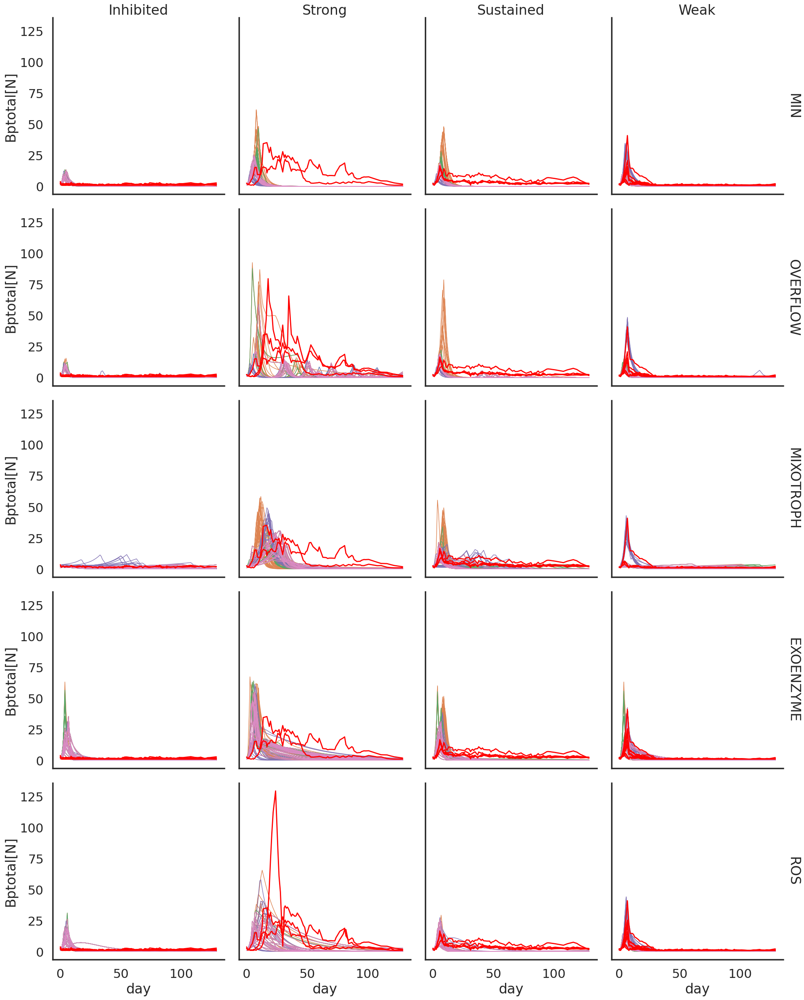

In [78]:
    n='N'
    #mrows = mean_scores.loc[mean_scores.lrank.le(5)] #& mean_scores.loss.isin([method])]
    tmp_df = df.loc[#sdf[f'Bptotal[{n}]'].ge(1e-1) 
        #             & 
        df.run_id.isin(mrows.run_id)]
    tmp_df = pd.merge(tmp_df, mrows, on=['run_id', 'model' ])
    tmp_df
    l= 'lRMSE'
    g = sns.relplot(
        data=tmp_df,
        kind='line', 
        estimator=None, units='idx',
        x='day', y=f'Bptotal[{n}]', 
        col='Group', #col_order=media_order, 
        lw=1,
        hue='loss', #hue_order=morder, palette=mpalette,
        row='model', #row_order=morder, 
        facet_kws=dict( margin_titles=True),
        legend=False
    )
    for (row_val,col_val), ax in g.axes_dict.items():
        refsamples = mrows.loc[mrows.Group.isin([col_val]) & mrows.model.isin([row_val]) ]
        sns.lineplot(
            data=refdf.loc[refdf['Sample'].isin(refsamples['Sample']) ], # &refdf[f'ref_Bp[{n}]'].ge(4)
            x='day', y=f'ref_Bp[{n}]',
        units='Sample', estimator=None, ax=ax, lw=2, color='red',

                     legend=False
                    )
    #g.set(yscale='log')
    g.set_titles(col_template='{col_name}', row_template='{row_name}')
    #plt.suptitle(f'{method}', y=1.03)

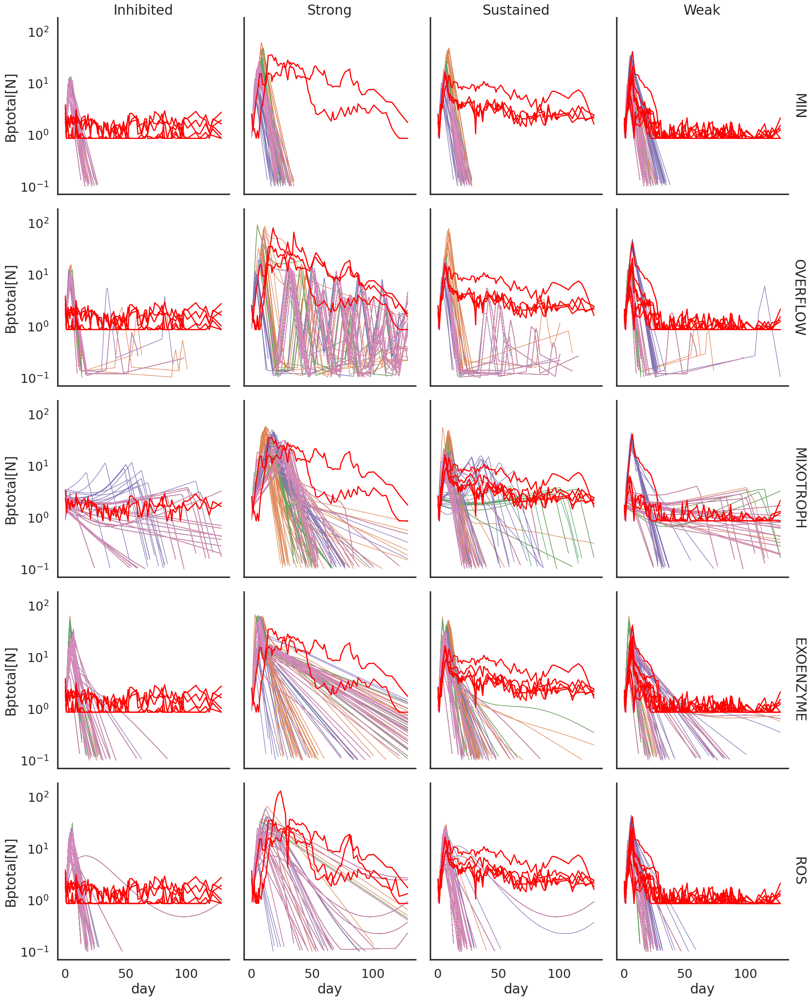

In [80]:
    n='N'
    #mrows = mean_scores.loc[mean_scores.lrank.le(5)] #& mean_scores.loss.isin([method])]
    tmp_df = df.loc[df[f'Bptotal[{n}]'].ge(1e-1) 
                     & df.run_id.isin(mrows.run_id)]
    tmp_df = pd.merge(tmp_df, mrows, on=['run_id', 'model' ])
    #tmp_df
    l= 'lRMSE'
    g = sns.relplot(
        data=tmp_df,
        kind='line', 
        estimator=None, units='idx',
        x='day', y=f'Bptotal[{n}]', 
        col='Group', #col_order=media_order, 
        lw=1,
        hue='loss', #hue_order=morder, palette=mpalette,
        row='model', #row_order=morder, 
        facet_kws=dict( margin_titles=True),
        legend=False
    )
    for (row_val,col_val), ax in g.axes_dict.items():
        refsamples = mrows.loc[mrows.Group.isin([col_val]) & mrows.model.isin([row_val]) ]
        sns.lineplot(
            data=refdf.loc[refdf['Sample'].isin(refsamples['Sample']) ], # &refdf[f'ref_Bp[{n}]'].ge(4)
            x='day', y=f'ref_Bp[{n}]',
        units='Sample', estimator=None, ax=ax, lw=2, color='red',

                     legend=False
                    )
    g.set(yscale='log')
    g.set_titles(col_template='{col_name}', row_template='{row_name}')
    #plt.suptitle(f'{method}', y=1.03)

In [82]:
min_mse_df = mean_scores.loc[mean_scores.groupby(['run_id', 'loss_param']).loss_value.idxmin()].reset_index(drop=True)
min_mse_df

,run_id,Sample,full name,Group,compare_points,loss_param,loss_value,model,loss,f_scale,lrank
0,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,9C0,E. coli,Weak,74.0,RMSE,595.661634,EXOENZYME,RMSE,1,6015.0
1,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,9C0,E. coli,Weak,74.0,arctan_0.01,0.003091,EXOENZYME,arctan,0.01,6506.0
2,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,9C0,E. coli,Weak,74.0,arctan_0.1,0.299130,EXOENZYME,arctan,0.1,5933.0
3,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,9C0,E. coli,Weak,74.0,arctan_1.0,24.038551,EXOENZYME,arctan,1.0,4307.0
4,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,9C0,E. coli,Weak,74.0,arctan_10.0,982.020552,EXOENZYME,arctan,10.0,6492.0
...,...,...,...,...,...,...,...,...,...,...,...
979193,monte3_ROS_99_monte_shgo4_sobol_928_ROS_56_low...,2B0,A. macleodii 1A3,Strong,74.0,softl1_0.01,26.268589,ROS,softl1,0.01,4700.0
979194,monte3_ROS_99_monte_shgo4_sobol_928_ROS_56_low...,2B0,A. macleodii 1A3,Strong,74.0,softl1_0.1,261.663427,ROS,softl1,0.1,4699.0
979195,monte3_ROS_99_monte_shgo4_sobol_928_ROS_56_low...,2B0,A. macleodii 1A3,Strong,74.0,softl1_1.0,2528.601035,ROS,softl1,1.0,4696.0
979196,monte3_ROS_99_monte_shgo4_sobol_928_ROS_56_low...,2B0,A. macleodii 1A3,Strong,74.0,softl1_10.0,20606.596972,ROS,softl1,10.0,4693.0


In [83]:
min_mse_df.to_csv('min_mse_df.csv.gz')

In [85]:
mean_scores.shape, mrows.shape

((3916792, 11), (10800, 11))

In [88]:
mrows.loss_param.nunique(),  mean_scores.loss_param.nunique(), min_mse_df.loss_param.nunique()

(27, 27, 27)

In [93]:
min_mse_df.groupby('run_id').loss_param.size()

run_id
monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXOENZYME_5_lowN_all_EXOENZYME_h1628948357718170805     27
monte3_EXOENZYME_100_monte_shgo3_sobol_163_EXOENZYME_40_lowN_all_EXOENZYME_h1628948357718170805    27
monte3_EXOENZYME_100_monte_shgo3_sobol_163_EXOENZYME_69_lowN_all_EXOENZYME_h1628948357718170805    27
monte3_EXOENZYME_100_monte_shgo3_sobol_199_EXOENZYME_33_lowN_all_EXOENZYME_h1628948357718170805    27
monte3_EXOENZYME_100_monte_shgo3_sobol_199_EXOENZYME_66_lowN_all_EXOENZYME_h1628948357718170805    27
                                                                                                   ..
monte3_ROS_99_monte_shgo4_sobol_69_ROS_73_lowN_all_ROS_h5853139000967720769                        27
monte3_ROS_99_monte_shgo4_sobol_739_ROS_50_lowN_all_ROS_h5853139000967720769                       27
monte3_ROS_99_monte_shgo4_sobol_829_ROS_30_lowN_all_ROS_h5853139000967720769                       27
monte3_ROS_99_monte_shgo4_sobol_915_ROS_48_lowN_all_ROS_h585313900096772076

In [94]:
min_mse_df.groupby(['model', 'loss_param', 'loss', 'f_scale', 'Group']).size()

model      loss_param    loss    f_scale  Group    
EXOENZYME  RMSE          RMSE    1        Inhibited       1
                                          Strong         12
                                          Sustained       4
                                          Weak         9925
           arctan_0.01   arctan  0.01     Inhibited    2547
                                                       ... 
ROS        softl1_10.0   softl1  10.0     Sustained       5
                                          Weak         4490
           softl1_100.0  softl1  100.0    Strong        233
                                          Sustained      11
                                          Weak         4585
Length: 425, dtype: int64

In [105]:
min_mse_df.loc[min_mse_df.f_scale.isin([1]), 'f_scale'] = '1.0'

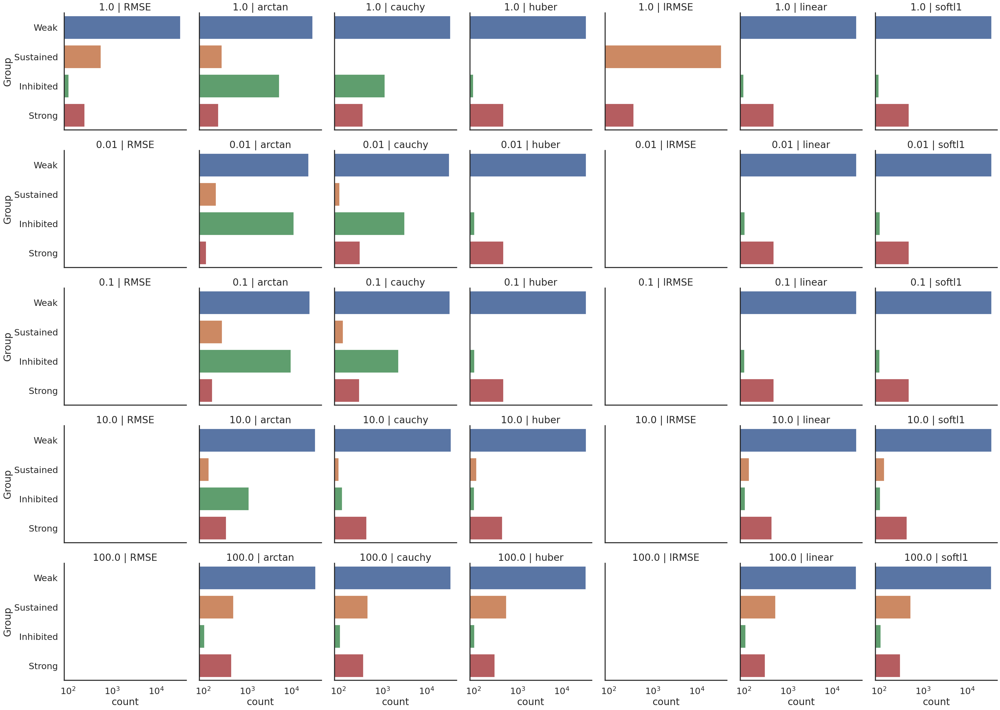

In [108]:
sns.catplot(
    data=min_mse_df,
    y='Group', #hue='model', 
    col='loss', row='f_scale',
    #hue_order=morder, palette=mpalette,
    kind='count', #stat='percent',
    facet_kws=dict(sharex=False, margin_titles=True),
).set_titles(col_template='{col_name}', row_template='{row_name}').set(xscale='log')

In [109]:
mean_scores.head()

,run_id,Sample,full name,Group,compare_points,loss_param,loss_value,model,loss,f_scale,lrank
0,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,3B0,Marinobacter adhaerens HP15,Inhibited,74.0,RMSE,1406.913912,EXOENZYME,RMSE,1,5957.0
1,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,3A0,Marinobacter adhaerens HP15,Inhibited,74.0,arctan_0.01,0.003096,EXOENZYME,arctan,0.01,6638.0
2,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,3A0,Marinobacter adhaerens HP15,Inhibited,74.0,arctan_0.1,0.306578,EXOENZYME,arctan,0.1,6519.0
3,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,4A0,Phaeobacter gallaeciensis,Inhibited,74.0,arctan_1.0,27.163920,EXOENZYME,arctan,1.0,6271.0
4,monte3_EXOENZYME_100_monte_shgo3_sobol_151_EXO...,4A0,Phaeobacter gallaeciensis,Inhibited,74.0,arctan_10.0,1302.518549,EXOENZYME,arctan,10.0,6156.0


In [148]:
multi_assigned_ids = min_mse_df.loc[
    ~min_mse_df.loss.isin(['lRMSE'])
].groupby(['run_id', 'model']).agg(dict(Group='nunique', lrank='median')).reset_index()

In [149]:
multi_assigned_ids.sort_values(['Group', 'lrank'], ascending=[False, True]).head(15)


,run_id,model,Group,lrank
2841,monte3_EXOENZYME_35_monte_shgo3_sobol_768_EXOE...,EXOENZYME,4,221.0
2842,monte3_EXOENZYME_35_monte_shgo3_sobol_768_EXOE...,EXOENZYME,4,336.0
4904,monte3_EXOENZYME_54_monte_shgo3_sobol_288_EXOE...,EXOENZYME,4,482.5
26405,monte3_MIXOTROPH_87_monte_shgo3_sobol_449_MIXO...,MIXOTROPH,4,1662.0
737,monte3_EXOENZYME_16_monte_shgo3_sobol_760_EXOE...,EXOENZYME,4,1725.0
24815,monte3_MIXOTROPH_54_monte_shgo3_sobol_449_MIXO...,MIXOTROPH,4,2052.0
447,monte3_EXOENZYME_13_monte_shgo3_sobol_760_EXOE...,EXOENZYME,4,2453.5
2910,monte3_EXOENZYME_36_monte_shgo3_sobol_288_EXOE...,EXOENZYME,4,2584.0
4607,monte3_EXOENZYME_51_monte_shgo3_sobol_288_EXOE...,EXOENZYME,4,2622.0
22937,monte3_MIXOTROPH_37_monte_shgo3_sobol_449_MIXO...,MIXOTROPH,4,2763.0


In [150]:
#top_problematic = 
multi_assigned_ids.loc[multi_assigned_ids.Group>2].sort_values(['lrank', 'Group', ], ascending=[ True, False,]).head(15)


,run_id,model,Group,lrank
34901,monte3_ROS_77_monte_shgo3_sobol_703_ROS_15_low...,ROS,3,8.0
20624,monte3_MIXOTROPH_15_monte_shgo4_sobol_808_MIXO...,MIXOTROPH,3,11.0
12127,monte3_MIN_29_monte_shgo3_sobol_770_MIN_60_low...,MIN,3,22.0
18351,monte3_MIN_86_monte_shgo3_sobol_134_MIN_68_low...,MIN,3,23.0
34389,monte3_ROS_67_monte_shgo4_sobol_902_ROS_41_low...,ROS,3,28.5
6774,monte3_EXOENZYME_70_monte_shgo4_sobol_575_EXOE...,EXOENZYME,3,29.0
33409,monte3_ROS_52_monte_shgo4_sobol_188_ROS_8_lowN...,ROS,3,29.5
35078,monte3_ROS_82_monte_shgo4_sobol_902_ROS_7_lowN...,ROS,3,30.0
32530,monte3_ROS_35_monte_shgo4_sobol_188_ROS_3_lowN...,ROS,3,36.0
34659,monte3_ROS_71_monte_shgo4_sobol_928_ROS_67_low...,ROS,3,53.5


In [151]:
top_problematic = multi_assigned_ids.loc[multi_assigned_ids.Group>2].sort_values(['lrank', 'Group', ], ascending=[ True, False,]).head(10)


In [152]:
runid = 'monte3_EXOENZYME_97_monte_shgo3_sobol_768_EXOENZYME_26_lowN_all_EXOENZYME_h1628948357718170805'

In [153]:
top_problematic

,run_id,model,Group,lrank
34901,monte3_ROS_77_monte_shgo3_sobol_703_ROS_15_low...,ROS,3,8.0
20624,monte3_MIXOTROPH_15_monte_shgo4_sobol_808_MIXO...,MIXOTROPH,3,11.0
12127,monte3_MIN_29_monte_shgo3_sobol_770_MIN_60_low...,MIN,3,22.0
18351,monte3_MIN_86_monte_shgo3_sobol_134_MIN_68_low...,MIN,3,23.0
34389,monte3_ROS_67_monte_shgo4_sobol_902_ROS_41_low...,ROS,3,28.5
6774,monte3_EXOENZYME_70_monte_shgo4_sobol_575_EXOE...,EXOENZYME,3,29.0
33409,monte3_ROS_52_monte_shgo4_sobol_188_ROS_8_lowN...,ROS,3,29.5
35078,monte3_ROS_82_monte_shgo4_sobol_902_ROS_7_lowN...,ROS,3,30.0
32530,monte3_ROS_35_monte_shgo4_sobol_188_ROS_3_lowN...,ROS,3,36.0
34659,monte3_ROS_71_monte_shgo4_sobol_928_ROS_67_low...,ROS,3,53.5


In [154]:
tdf =df.loc[df.run_id.isin(top_problematic.run_id)]

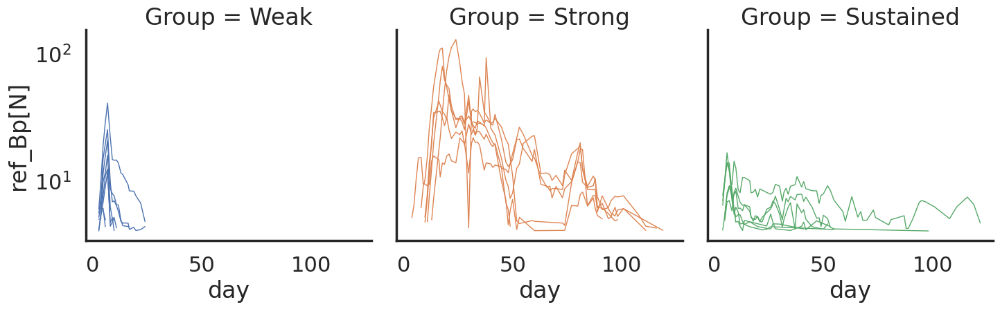

In [162]:
sns.relplot(
    data=refdf.loc[refdf[f'ref_Bp[{n}]'].ge(4)],
    x='day', y=f'ref_Bp[{n}]', col='Group', hue='Group',
units='Sample', estimator=None, lw=1, kind='line',
             legend=False
            ).set(yscale='log')

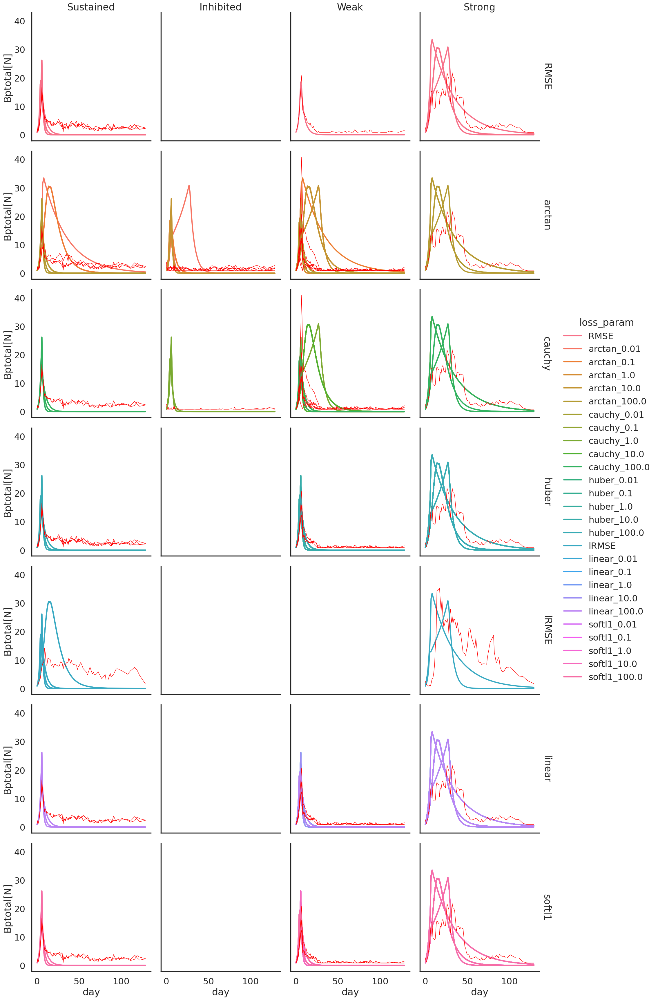

In [155]:
    n='N'
    #mrows = mean_scores.loc[mean_scores.lrank.le(5)] #& mean_scores.loss.isin([method])]
    tmp_df = tdf
    tmp_df = pd.merge(tmp_df, min_mse_df, on=['run_id', 'model' ], how='left')
    tmp_df
    l= 'lRMSE'
    g = sns.relplot(
        data=tmp_df,
        kind='line', 
        estimator=None, units='idx',
        x='day', y=f'Bptotal[{n}]', 
        col='Group', #col_order=media_order, 
        lw=3,
        hue='loss_param', #hue_order=morder, palette=mpalette,
        row='loss', #row_order=morder, 
        facet_kws=dict( margin_titles=True),
        #legend=False
    )
    for (row_val,col_val), ax in g.axes_dict.items():
        refsamples = min_mse_df.loc[
            min_mse_df.run_id.isin(top_problematic.run_id) &
            min_mse_df.Group.isin([col_val]) & 
            min_mse_df.loss.isin([row_val]) ]
        sns.lineplot(
            data=refdf.loc[refdf['Sample'].isin(refsamples['Sample']) ], # &refdf[f'ref_Bp[{n}]'].ge(4)
            x='day', y=f'ref_Bp[{n}]',
        units='Sample', estimator=None, ax=ax, lw=1, color='red',

                     legend=False
                    )
    #g.set(yscale='log')
    g.set_titles(col_template='{col_name}', row_template='{row_name}')
    #plt.suptitle(f'{method}', y=1.03)

In [154]:
mse_df.groupby('Group')[['lRMSE']].describe().T

Group            Inhibited         Strong      Sustained           Weak
lRMSE count  243420.000000  243420.000000  243420.000000  365130.000000
      mean        5.810859       2.603044       2.760250       5.181374
      std         0.763751       0.405590       0.593607       0.539229
      min         4.269507       1.427273       1.098078       4.135227
      25%         5.108184       2.335433       2.519916       4.830233
      50%         5.791880       2.521253       2.895341       5.141421
      75%         6.540657       2.748253       3.200091       5.648181
      max         9.470078       3.997171       5.857263       8.665574

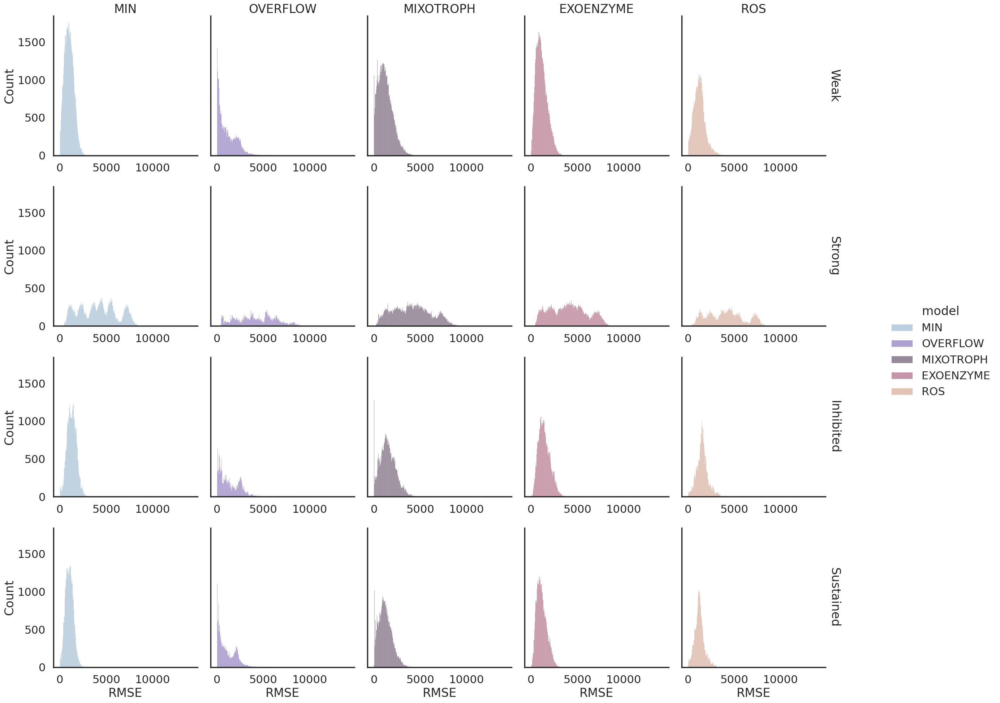

In [155]:
sns.displot(
    data=mse_df, x='RMSE',
    col='model', row='Group', col_order=morder,
    hue='model', palette=mpalette, hue_order=morder,
    facet_kws=dict(sharex=False, margin_titles=True),
).set_titles(col_template='{col_name}', row_template='{row_name}')

In [156]:
(10000 - sum_df['model'].value_counts())/100

EXOENZYME     0.47
MIN           0.63
MIXOTROPH     1.14
ROS          37.23
OVERFLOW     53.89
Name: model, dtype: float64

In [157]:
mse_df.columns

Index(['Sample', 'full name', 'Group', 'RMSE_Bptotal[N]', 'RMSE_Bptotal[C]',
       'RMSE_log_Bptotal[N]', 'RMSE_log_Bptotal[C]', 'compare_points', 'RMSE',
       'lRMSE', 'run_id', 'idx', 'media', 'which', 'model', 'hash', 'vpro',
       'ref_compare_points'],
      dtype='object')

In [158]:
mean_scores = mse_df.loc[mse_df.groupby(['run_id', 'Group']).RMSE.idxmin()].reset_index(drop=True)


In [159]:
mean_scores

,Sample,full name,Group,RMSE_Bptotal[N],RMSE_Bptotal[C],RMSE_log_Bptotal[N],RMSE_log_Bptotal[C],compare_points,RMSE,lRMSE,run_id,idx,media,which,model,hash,vpro,ref_compare_points
0,3C0,Marinobacter adhaerens HP15,Inhibited,14.507679,143.608724,2.617457,2.061320,74.0,2083.429217,5.395416,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_58,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
1,5A0,Pseudoalteromonas haloplanktis,Strong,13.618257,128.693758,2.140458,1.157662,74.0,1752.584660,2.477927,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_58,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
2,6C0,Ruegeria pomeroyi,Sustained,12.766324,127.192426,2.537352,1.337798,74.0,1623.779711,3.394465,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_58,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
3,9C0,E. coli,Weak,8.423241,96.697692,2.392486,1.787239,74.0,814.507962,4.275944,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_58,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
4,3C0,Marinobacter adhaerens HP15,Inhibited,13.507732,133.971911,2.615653,2.040922,74.0,1809.656615,5.338343,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_59,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
162275,9C0,E. coli,Weak,8.631288,79.994080,2.392140,1.776292,74.0,690.451966,4.249138,monte_ROS_9_monte_vpro_4901_ROS_5_lowN_all_ROS...,monte_ROS_9_monte_vpro_4901_ROS_5,lowN,all,ROS,h5853139000967720769,vpro_4901_ROS,74
162276,3B0,Marinobacter adhaerens HP15,Inhibited,13.548694,113.652728,2.616082,1.961246,74.0,1539.846043,5.130780,monte_ROS_9_monte_vpro_4933_ROS_8_lowN_all_ROS...,monte_ROS_9_monte_vpro_4933_ROS_8,lowN,all,ROS,h5853139000967720769,vpro_4933_ROS,74
162277,5A0,Pseudoalteromonas haloplanktis,Strong,12.506562,100.830220,2.139052,1.097191,74.0,1261.039372,2.346950,monte_ROS_9_monte_vpro_4933_ROS_8_lowN_all_ROS...,monte_ROS_9_monte_vpro_4933_ROS_8,lowN,all,ROS,h5853139000967720769,vpro_4933_ROS,74
162278,7A0,Sulfitobacter pseudonitzschiae,Sustained,11.818509,98.457126,2.115404,0.778636,74.0,1163.616389,1.647131,monte_ROS_9_monte_vpro_4933_ROS_8_lowN_all_ROS...,monte_ROS_9_monte_vpro_4933_ROS_8,lowN,all,ROS,h5853139000967720769,vpro_4933_ROS,74


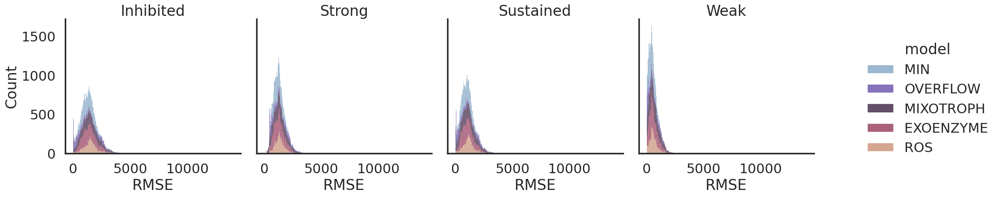

In [167]:
sns.displot(
    data=mean_scores, x='RMSE',
    #col='model', 
    col='Group', #col_order=morder,
    hue='model', palette=mpalette, hue_order=morder, multiple='stack',
    facet_kws=dict(sharex=False, margin_titles=True),
).set_titles(col_template='{col_name}', row_template='{row_name}')

In [161]:
min_mse_df = mse_df.loc[mse_df.groupby('run_id').RMSE.idxmin()].reset_index(drop=True)
min_mse_df

,Sample,full name,Group,RMSE_Bptotal[N],RMSE_Bptotal[C],RMSE_log_Bptotal[N],RMSE_log_Bptotal[C],compare_points,RMSE,lRMSE,run_id,idx,media,which,model,hash,vpro,ref_compare_points
0,9C0,E. coli,Weak,8.423241,96.697692,2.392486,1.787239,74.0,814.507962,4.275944,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_58,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
1,9C0,E. coli,Weak,7.507977,87.210306,2.392027,1.780333,74.0,654.772941,4.258605,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_59,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
2,9C0,E. coli,Weak,7.256088,79.046364,2.392087,1.768673,74.0,573.567336,4.230819,monte_EXOENZYME_100_monte_vpro_3199_EXOENZYME_...,monte_EXOENZYME_100_monte_vpro_3199_EXOENZYME_60,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74
3,9C0,E. coli,Weak,3.911785,48.570265,2.391466,1.746319,74.0,189.996439,4.176264,monte_EXOENZYME_100_monte_vpro_3199_EXOENZYME_...,monte_EXOENZYME_100_monte_vpro_3199_EXOENZYME_99,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74
4,9C0,E. coli,Weak,8.269378,94.169647,2.392260,1.777747,74.0,778.724419,4.252833,monte_EXOENZYME_100_monte_vpro_323_EXOENZYME_2...,monte_EXOENZYME_100_monte_vpro_323_EXOENZYME_20,lowN,all,EXOENZYME,h1628948357718170805,vpro_323_EXOENZYME,74
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40565,9C0,E. coli,Weak,7.277674,75.438831,2.391783,1.772229,74.0,549.019192,4.238786,monte_ROS_9_monte_vpro_4386_ROS_1_lowN_all_ROS...,monte_ROS_9_monte_vpro_4386_ROS_1,lowN,all,ROS,h5853139000967720769,vpro_4386_ROS,74
40566,9C0,E. coli,Weak,5.609242,61.175070,2.391477,1.760834,74.0,343.145794,4.210996,monte_ROS_9_monte_vpro_4386_ROS_3_lowN_all_ROS...,monte_ROS_9_monte_vpro_4386_ROS_3,lowN,all,ROS,h5853139000967720769,vpro_4386_ROS,74
40567,9C0,E. coli,Weak,9.423478,97.753560,2.392085,1.801257,74.0,921.178543,4.308759,monte_ROS_9_monte_vpro_4511_ROS_0_lowN_all_ROS...,monte_ROS_9_monte_vpro_4511_ROS_0,lowN,all,ROS,h5853139000967720769,vpro_4511_ROS,74
40568,9C0,E. coli,Weak,8.631288,79.994080,2.392140,1.776292,74.0,690.451966,4.249138,monte_ROS_9_monte_vpro_4901_ROS_5_lowN_all_ROS...,monte_ROS_9_monte_vpro_4901_ROS_5,lowN,all,ROS,h5853139000967720769,vpro_4901_ROS,74


In [162]:
min_mse_df.Group.value_counts()

Weak         39822
Sustained      411
Inhibited      228
Strong         109
Name: Group, dtype: int64

In [163]:
mean_scores.Group.value_counts()

Inhibited    40570
Strong       40570
Sustained    40570
Weak         40570
Name: Group, dtype: int64

In [164]:
min_mse_df[[ 'model',  'Group', ]].value_counts().reset_index().sort_values(['model'])

,model,Group,0
0,EXOENZYME,Weak,9930
9,EXOENZYME,Strong,19
14,EXOENZYME,Sustained,4
1,MIN,Weak,9922
11,MIN,Sustained,14
15,MIN,Inhibited,1
2,MIXOTROPH,Weak,9242
5,MIXOTROPH,Sustained,351
6,MIXOTROPH,Inhibited,227
7,MIXOTROPH,Strong,66


In [165]:
mean_scores

,Sample,full name,Group,RMSE_Bptotal[N],RMSE_Bptotal[C],RMSE_log_Bptotal[N],RMSE_log_Bptotal[C],compare_points,RMSE,lRMSE,run_id,idx,media,which,model,hash,vpro,ref_compare_points
0,3C0,Marinobacter adhaerens HP15,Inhibited,14.507679,143.608724,2.617457,2.061320,74.0,2083.429217,5.395416,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_58,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
1,5A0,Pseudoalteromonas haloplanktis,Strong,13.618257,128.693758,2.140458,1.157662,74.0,1752.584660,2.477927,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_58,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
2,6C0,Ruegeria pomeroyi,Sustained,12.766324,127.192426,2.537352,1.337798,74.0,1623.779711,3.394465,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_58,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
3,9C0,E. coli,Weak,8.423241,96.697692,2.392486,1.787239,74.0,814.507962,4.275944,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_58,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
4,3C0,Marinobacter adhaerens HP15,Inhibited,13.507732,133.971911,2.615653,2.040922,74.0,1809.656615,5.338343,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME...,monte_EXOENZYME_100_monte_vpro_31007_EXOENZYME_59,lowN,all,EXOENZYME,h1628948357718170805,vpro_31007_EXOENZYME,74
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
162275,9C0,E. coli,Weak,8.631288,79.994080,2.392140,1.776292,74.0,690.451966,4.249138,monte_ROS_9_monte_vpro_4901_ROS_5_lowN_all_ROS...,monte_ROS_9_monte_vpro_4901_ROS_5,lowN,all,ROS,h5853139000967720769,vpro_4901_ROS,74
162276,3B0,Marinobacter adhaerens HP15,Inhibited,13.548694,113.652728,2.616082,1.961246,74.0,1539.846043,5.130780,monte_ROS_9_monte_vpro_4933_ROS_8_lowN_all_ROS...,monte_ROS_9_monte_vpro_4933_ROS_8,lowN,all,ROS,h5853139000967720769,vpro_4933_ROS,74
162277,5A0,Pseudoalteromonas haloplanktis,Strong,12.506562,100.830220,2.139052,1.097191,74.0,1261.039372,2.346950,monte_ROS_9_monte_vpro_4933_ROS_8_lowN_all_ROS...,monte_ROS_9_monte_vpro_4933_ROS_8,lowN,all,ROS,h5853139000967720769,vpro_4933_ROS,74
162278,7A0,Sulfitobacter pseudonitzschiae,Sustained,11.818509,98.457126,2.115404,0.778636,74.0,1163.616389,1.647131,monte_ROS_9_monte_vpro_4933_ROS_8_lowN_all_ROS...,monte_ROS_9_monte_vpro_4933_ROS_8,lowN,all,ROS,h5853139000967720769,vpro_4933_ROS,74


In [168]:
mean_scores['rank'] = mean_scores.groupby(['Group', "model"])["RMSE"].rank(method='first')


In [170]:
mean_scores.groupby(['Group', "model"])['rank'].describe().T

Group    Inhibited                                                      \
model    EXOENZYME          MIN    MIXOTROPH     OVERFLOW          ROS   
count  9953.000000  9937.000000  9886.000000  4517.000000  6277.000000   
mean   4977.000000  4969.000000  4943.500000  2259.000000  3139.000000   
std    2873.327949  2868.709146  2853.986715  1304.089913  1812.158152   
min       1.000000     1.000000     1.000000     1.000000     1.000000   
25%    2489.000000  2485.000000  2472.250000  1130.000000  1570.000000   
50%    4977.000000  4969.000000  4943.500000  2259.000000  3139.000000   
75%    7465.000000  7453.000000  7414.750000  3388.000000  4708.000000   
max    9953.000000  9937.000000  9886.000000  4517.000000  6277.000000   

Group       Strong                                                      \
model    EXOENZYME          MIN    MIXOTROPH     OVERFLOW          ROS   
count  9953.000000  9937.000000  9886.000000  4517.000000  6277.000000   
mean   4977.000000  4969.000000  4943.500000  2259.000000  3139.000000   
std    2873.327949  2868.709146  2853.986715  1304.089913  1812.158152   
min       1.000000     1.000000     1.000000     1.000000     1.000000   
25%    2489.000000  2485.000000  2472.250000  1130.000000  1570.000000   
50%    4977.000000  4969.000000  4943.500000  2259.000000  3139.000000   
75%    7465.000000  7453.000000  7414.750000  3388.000000  4708.000000   
max    9953.000000  9937.000000  9886.000000  4517.000000  6277.000000   

Group    Sustained                                                      \
model    EXOENZYME          MIN    MIXOTROPH     OVERFLOW          ROS   
count  9953.000000  9937.000000  9886.000000  4517.000000  6277.000000   
mean   4977.000000  4969.000000  4943.500000  2259.000000  3139.000000   
std    2873.327949  2868.709146  2853.986715  1304.089913  1812.158152   
min       1.000000     1.000000     1.000000     1.000000     1.000000   
25%    2489.000000  2485.000000  2472.250000  1130.000000  1570.000000   
50%    4977.000000  4969.000000  4943.500000  2259.000000  3139.000000   
75%    7465.000000  7453.000000  7414.750000  3388.000000  4708.000000   
max    9953.000000  9937.000000  9886.000000  4517.000000  6277.000000   

Group         Weak                                                      
model    EXOENZYME          MIN    MIXOTROPH     OVERFLOW          ROS  
count  9953.000000  9937.000000  9886.000000  4517.000000  6277.000000  
mean   4977.000000  4969.000000  4943.500000  2259.000000  3139.000000  
std    2873.327949  2868.709146  2853.986715  1304.089913  1812.158152  
min       1.000000     1.000000     1.000000     1.000000     1.000000  
25%    2489.000000  2485.000000  2472.250000  1130.000000  1570.000000  
50%    4977.000000  4969.000000  4943.500000  2259.000000  3139.000000  
75%    7465.000000  7453.000000  7414.750000  3388.000000  4708.000000  
max    9953.000000  9937.000000  9886.000000  4517.000000  6277.000000

In [171]:
mrows = mean_scores.loc[mean_scores['rank'].le(10)]

In [172]:
mrows.Group.value_counts()

Strong       50
Inhibited    50
Sustained    50
Weak         50
Name: Group, dtype: int64

In [ ]:
tmp_df = df.loc[df[f'Bptotal[{n}]'].ge(1e-1) 
                & df.idx.isin(mrows.idx)]
tmp_df = pd.merge(tmp_df, mrows, on=['run_id', 'model', 'vpro','idx'])
for n in ('N'):
    l= 'lRMSE'
    g = sns.relplot(
        data=tmp_df,
        kind='line', 
        estimator=None, units='idx',
        x='day', y=f'Bptotal[{n}]', 
        col='Group', #col_order=media_order, 
        lw=1,
        hue='model', hue_order=morder, palette=mpalette,
        row='model', row_order=morder, 
        facet_kws=dict( margin_titles=True),
        legend=False
    )
    for (row_val,col_val), ax in g.axes_dict.items():
        refsamples = mrows.loc[mrows.model.isin([row_val]) & mrows.Group.isin([col_val]) ]
        sns.lineplot(
            data=refdf.loc[refdf['Sample'].isin(refsamples['Sample']) ], # &refdf[f'ref_Bp[{n}]'].ge(4)
            x='day', y=f'ref_Bp[{n}]',
        units='Sample', estimator=None, ax=ax, lw=2, color='red',

                     legend=False
                    )
    g.set(yscale='log')
    g.set_titles(col_template='{col_name}', row_template='{row_name}')
    plt.suptitle(f'{n} - top models ({l})', y=1.03)

In [175]:
refdf.loc[refdf['ref_Bp[N]'].ge(4)].groupby('Group').day.max()

Group
Axenic        25.734722
Strong       118.788889
Sustained    121.777778
Weak          23.898611
Name: day, dtype: float64

In [177]:
refdf.loc[refdf['ref_Bp[C]'].ge(4*6)].groupby('Group').day.max()

Group
Axenic        25.734722
Inhibited      0.000000
Strong       118.788889
Sustained    121.777778
Weak          25.734722
Name: day, dtype: float64

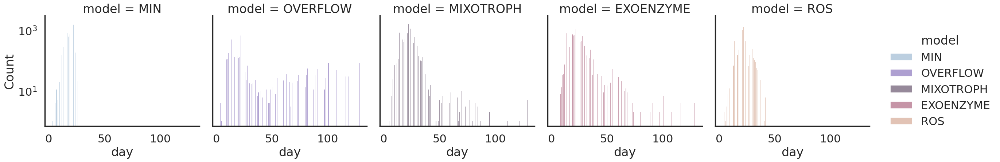

In [185]:
maxday_df = df.loc[df['Bptotal[N]'].ge(4)].groupby(['model', 'idx']).day.max().reset_index()
sns.displot(
    data=maxday_df,
    hue='model',hue_order=morder, palette=mpalette, #multiple='stack', #log_scale=
    col='model', col_order=morder,
    x='day')
plt.yscale('log')

In [76]:
mse_df.groupby(['model', 'full name']).size()

model      full name                     
EXOENZYME  A. macleodii 1A3                  30000
           Axenic                            30000
           E. coli                           30000
           Marinobacter adhaerens HP15       30000
           Marinovum 5F3                     30000
           Phaeobacter gallaeciensis         30000
           Pseudoalteromonas haloplanktis    30000
           Roseovarius 5C3                   30000
           Ruegeria pomeroyi                 30000
           Sulfitobacter pseudonitzschiae    30000
MIN        A. macleodii 1A3                  30000
           Axenic                            30000
           E. coli                           30000
           Marinobacter adhaerens HP15       30000
           Marinovum 5F3                     30000
           Phaeobacter gallaeciensis         30000
           Pseudoalteromonas haloplanktis    30000
           Roseovarius 5C3                   30000
           Ruegeria pomeroyi            

In [115]:
mrows.loc[mrows.Group.isin(['Inhibited'])]

,Sample,full name,Group,RMSE_Bptotal[N],RMSE_Bptotal[C],RMSE_log_Bptotal[N],RMSE_log_Bptotal[C],compare_points,RMSE,lRMSE,run_id,idx,media,which,model,hash,vpro,ref_compare_points,lrank
4026,3B0,Marinobacter adhaerens HP15,Inhibited,1.316756,18.736455,2.613706,1.654029,74.0,24.671337,4.323145,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_5...,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74,3.0
11841,3B0,Marinobacter adhaerens HP15,Inhibited,3.724160,34.736513,2.613706,1.701424,74.0,129.364337,4.447021,monte_EXOENZYME_30_monte_vpro_4519_EXOENZYME_1...,monte_EXOENZYME_30_monte_vpro_4519_EXOENZYME_1,lowN,all,EXOENZYME,h1628948357718170805,vpro_4519_EXOENZYME,74,9.0
14201,3B0,Marinobacter adhaerens HP15,Inhibited,1.067912,13.243157,2.613706,1.638324,74.0,14.142529,4.282096,monte_EXOENZYME_35_monte_vpro_3911_EXOENZYME_2...,monte_EXOENZYME_35_monte_vpro_3911_EXOENZYME_27,lowN,all,EXOENZYME,h1628948357718170805,vpro_3911_EXOENZYME,74,2.0
16816,3B0,Marinobacter adhaerens HP15,Inhibited,3.650012,33.977247,2.613706,1.699949,74.0,124.017368,4.443166,monte_EXOENZYME_3_monte_vpro_4519_EXOENZYME_85...,monte_EXOENZYME_3_monte_vpro_4519_EXOENZYME_85,lowN,all,EXOENZYME,h1628948357718170805,vpro_4519_EXOENZYME,74,7.0
18241,3B0,Marinobacter adhaerens HP15,Inhibited,4.009887,30.787870,2.613706,1.690738,74.0,123.455886,4.419092,monte_EXOENZYME_42_monte_vpro_40_EXOENZYME_43_...,monte_EXOENZYME_42_monte_vpro_40_EXOENZYME_43,lowN,all,EXOENZYME,h1628948357718170805,vpro_40_EXOENZYME,74,6.0
18766,3B0,Marinobacter adhaerens HP15,Inhibited,3.453058,36.180655,2.613706,1.702445,74.0,124.933898,4.449690,monte_EXOENZYME_43_monte_vpro_4199_EXOENZYME_3...,monte_EXOENZYME_43_monte_vpro_4199_EXOENZYME_38,lowN,all,EXOENZYME,h1628948357718170805,vpro_4199_EXOENZYME,74,10.0
20386,3B0,Marinobacter adhaerens HP15,Inhibited,0.144877,10.614875,2.613706,1.633507,74.0,1.537854,4.269507,monte_EXOENZYME_46_monte_vpro_4892_EXOENZYME_9...,monte_EXOENZYME_46_monte_vpro_4892_EXOENZYME_90,lowN,all,EXOENZYME,h1628948357718170805,vpro_4892_EXOENZYME,74,1.0
26131,3B0,Marinobacter adhaerens HP15,Inhibited,1.822821,25.661910,2.613706,1.676713,74.0,46.777075,4.382435,monte_EXOENZYME_57_monte_vpro_388_EXOENZYME_25...,monte_EXOENZYME_57_monte_vpro_388_EXOENZYME_25,lowN,all,EXOENZYME,h1628948357718170805,vpro_388_EXOENZYME,74,4.0
37236,3B0,Marinobacter adhaerens HP15,Inhibited,4.039792,32.951147,2.613706,1.700576,74.0,133.115777,4.444804,monte_EXOENZYME_77_monte_vpro_4479_EXOENZYME_4...,monte_EXOENZYME_77_monte_vpro_4479_EXOENZYME_46,lowN,all,EXOENZYME,h1628948357718170805,vpro_4479_EXOENZYME,74,8.0
46101,3B0,Marinobacter adhaerens HP15,Inhibited,2.931695,27.875581,2.613706,1.684921,74.0,81.722714,4.403888,monte_EXOENZYME_93_monte_vpro_3992_EXOENZYME_5...,monte_EXOENZYME_93_monte_vpro_3992_EXOENZYME_59,lowN,all,EXOENZYME,h1628948357718170805,vpro_3992_EXOENZYME,74,5.0


In [116]:
mse_df.loc[mse_df.idx.isin(['monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53'])]

,Sample,full name,Group,RMSE_Bptotal[N],RMSE_Bptotal[C],RMSE_log_Bptotal[N],RMSE_log_Bptotal[C],compare_points,RMSE,lRMSE,run_id,idx,media,which,model,hash,vpro,ref_compare_points
226440,10A0,Marinovum 5F3,Weak,1.042023,13.388051,2.602587,1.983939,74.0,13.950655,5.163373,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_5...,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74
226441,10B0,Marinovum 5F3,Weak,1.221147,15.168948,2.607877,2.020348,74.0,18.523509,5.268819,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_5...,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74
226442,10C0,Marinovum 5F3,Weak,2.696239,16.549919,2.513142,1.769242,74.0,44.622532,4.446356,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_5...,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74
226443,11A0,Roseovarius 5C3,Weak,2.059899,11.826149,2.520956,1.853610,74.0,24.360669,4.672871,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_5...,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74
226444,11B0,Roseovarius 5C3,Weak,1.124866,10.270524,2.580636,1.881863,74.0,11.552962,4.856405,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_5...,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74
226445,11C0,Roseovarius 5C3,Weak,1.178161,14.686630,2.606288,2.007855,74.0,17.303215,5.233048,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_5...,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74
226446,1A0,Axenic,Axenic,10.331841,67.267557,2.362204,1.891274,74.0,694.997702,4.467575,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_5...,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74
226447,1B0,Axenic,Axenic,10.928720,70.635449,2.381689,1.916837,74.0,771.955080,4.565310,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_5...,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74
226448,1C0,Axenic,Axenic,10.584384,68.125237,2.386123,1.912743,74.0,721.063666,4.564038,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_5...,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74
226449,2A0,A. macleodii 1A3,Strong,19.336604,143.193366,1.738687,1.156435,74.0,2768.873408,2.010679,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_5...,monte_EXOENZYME_17_monte_vpro_3199_EXOENZYME_53,lowN,all,EXOENZYME,h1628948357718170805,vpro_3199_EXOENZYME,74


In [25]:
mean_scores['lRMSE'] = np.sqrt(mean_scores['lRMSE_lowN']*  mean_scores['lRMSE_pro99'])


array([-50.  , -49.01, -48.02, -47.03, -46.04, -45.05, -44.06, -43.07,
       -42.08, -41.09, -40.1 , -39.11, -38.12, -37.13, -36.14, -35.15,
       -34.16, -33.17, -32.18, -31.19, -30.2 , -29.21, -28.22, -27.23,
       -26.24, -25.25, -24.26, -23.27, -22.28, -21.29, -20.3 , -19.31,
       -18.32, -17.33, -16.34, -15.35, -14.36, -13.37, -12.38, -11.39,
       -10.4 ,  -9.41,  -8.42,  -7.43,  -6.44,  -5.45,  -4.46,  -3.47,
        -2.48,  -1.49,  -0.5 ,   0.49,   1.48,   2.47,   3.46,   4.45,
         5.44,   6.43,   7.42,   8.41,   9.4 ,  10.39,  11.38,  12.37,
        13.36,  14.35,  15.34,  16.33,  17.32,  18.31,  19.3 ,  20.29,
        21.28,  22.27,  23.26,  24.25,  25.24,  26.23,  27.22,  28.21,
        29.2 ,  30.19,  31.18,  32.17,  33.16,  34.15,  35.14,  36.13,
        37.12,  38.11,  39.1 ,  40.09,  41.08,  42.07,  43.06,  44.05,
        45.04,  46.03,  47.02,  48.01])

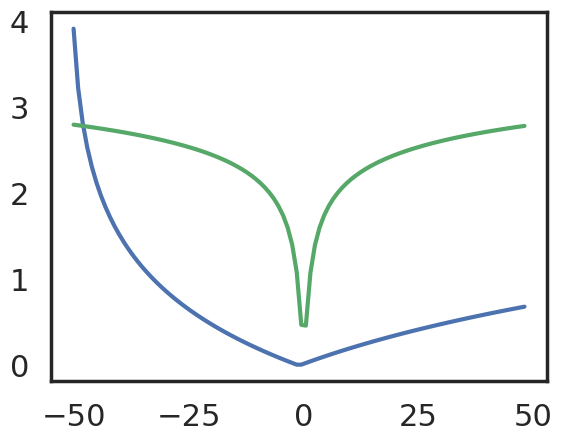

In [131]:
x =   np.arange(0, 100) - np.arange(0, 1, step=1e-2)
y =   np.arange(0, 100) - np.arange(0, 1, step=1e-2)
l2 = np.sqrt(np.square(x-50))
l3 = np.sqrt(np.square(np.log(x+1)-np.log(50)))
l4 = np.sqrt(np.log(1+np.square(x-50)))

#plt.plot(x-50, l2, c='r')
plt.plot(x-50, l3, c='b')
plt.plot(x-50, l4, c='g')
#y= np.arange(0, 100, step)
x-50

In [26]:
mean_scores.describe()

media,lRMSE_lowN,lRMSE_pro99,lRMSE
count,479.000000,479.000000,479.000000
mean,4.484836,1.718664,2.775151
std,0.058093,0.096187,0.078898
min,4.411928,1.455016,2.548859
25%,4.439692,1.660663,2.726067
50%,4.467000,1.722392,2.780738
75%,4.516756,1.777092,2.824526
max,4.692415,2.073266,3.050271


In [28]:
mean_scores.groupby('model').describe().T

model               EXOENZYME        MIN  MIXOTROPH   OVERFLOW        ROS
media                                                                    
lRMSE_lowN  count  100.000000  99.000000  96.000000  87.000000  97.000000
            mean     4.489162   4.473346   4.502542   4.470502   4.487434
            std      0.070398   0.044118   0.062400   0.056562   0.048211
            min      4.411928   4.414111   4.414158   4.412161   4.416716
            25%      4.430018   4.440886   4.457095   4.428365   4.454672
            50%      4.462753   4.458665   4.480495   4.453165   4.472480
            75%      4.532377   4.496970   4.546954   4.497141   4.514243
            max      4.689625   4.602273   4.692415   4.640298   4.624652
lRMSE_pro99 count  100.000000  99.000000  96.000000  87.000000  97.000000
            mean     1.673969   1.744783   1.710218   1.712118   1.752316
            std      0.095226   0.077102   0.082509   0.120726   0.082552
            min      1.457228   1.621159   1.492141   1.455016   1.571400
            25%      1.624257   1.695158   1.658856   1.624276   1.705942
            50%      1.670745   1.741736   1.709119   1.729400   1.732194
            75%      1.723793   1.777343   1.767282   1.799608   1.786975
            max      1.954872   2.073266   1.929206   1.931314   2.032510
lRMSE       count  100.000000  99.000000  96.000000  87.000000  97.000000
            mean     2.740135   2.793102   2.774114   2.764631   2.803392
            std      0.081146   0.064649   0.071162   0.094013   0.067024
            min      2.548859   2.686063   2.613147   2.569451   2.640650
            25%      2.689417   2.753478   2.724973   2.694254   2.768667
            50%      2.742557   2.796477   2.773881   2.787580   2.789429
            75%      2.788810   2.822851   2.831217   2.826001   2.830111
            max      2.971083   3.050271   2.965875   2.941155   3.014131

In [29]:
mean_scores['fit'] = 'bad'
mean_scores.loc[mean_scores.lRMSE< 3, 'fit'] = 'good'

In [30]:
mean_scores['lrank'] = mean_scores.groupby("model")["lRMSE"].transform("rank")
mean_scores['fit'] = 'bad'
mean_scores.loc[mean_scores.lrank.le(10), 'fit'] = 'good'

In [31]:
sns.set_context('poster')

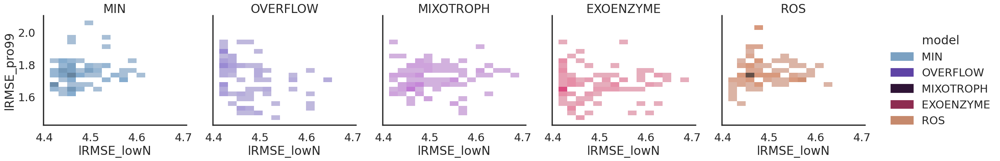

In [32]:
sns.displot(
    data=mean_scores,
    x='lRMSE_lowN',  y='lRMSE_pro99',
    hue='model', palette=mpalette, hue_order=morder,
    col='model', col_order=morder,
).set_titles(col_template='{col_name}', row_template='{row_name}')

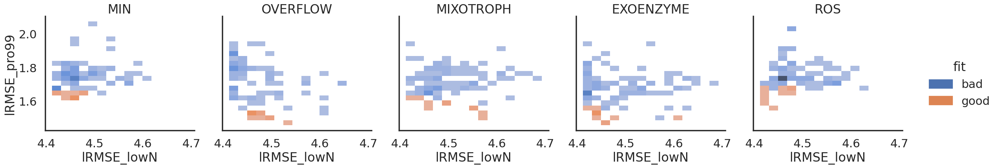

In [33]:
sns.displot(
    data=mean_scores,
    x='lRMSE_lowN',  y='lRMSE_pro99',
    #hue='model', palette=mpalette, hue_order=morder,
    hue='fit',
    col='model', col_order=morder,
).set_titles(col_template='{col_name}', row_template='{row_name}')

In [34]:
mean_scores.groupby(['model','fit']).size()

model      fit 
EXOENZYME  bad     90
           good    10
MIN        bad     89
           good    10
MIXOTROPH  bad     86
           good    10
OVERFLOW   bad     77
           good    10
ROS        bad     87
           good    10
dtype: int64

In [35]:
min_rows = mean_scores
min_rows

media,model,idx,lRMSE_lowN,lRMSE_pro99,lRMSE,fit,lrank
0,EXOENZYME,vpro_31007_EXOENZYME,4.485494,1.798158,2.840005,bad,89.0
1,EXOENZYME,vpro_3119_EXOENZYME,4.424643,1.637129,2.691415,bad,27.0
2,EXOENZYME,vpro_3135_EXOENZYME,4.517369,1.649727,2.729913,bad,43.0
3,EXOENZYME,vpro_3151_EXOENZYME,4.416625,1.780069,2.803908,bad,81.0
4,EXOENZYME,vpro_3163_EXOENZYME,4.456230,1.669943,2.727938,bad,40.0
...,...,...,...,...,...,...,...
474,ROS,vpro_4915_ROS,4.470662,1.899259,2.913923,bad,92.0
475,ROS,vpro_4917_ROS,4.452711,1.725501,2.771851,bad,27.0
476,ROS,vpro_4928_ROS,4.561066,1.705942,2.789429,bad,49.0
477,ROS,vpro_4933_ROS,4.472915,2.030092,3.013375,bad,96.0


### vmax per cell

uMN_per_cell = Qp = 12.5 fg/cell * 1e-9 fg->uM  / 14 (N MW)

vmax_per_sec_per_uMN = uM sec -1 uM N -1

vmax_per_day_per_uMN = vmax_per_sec_per_uMN * seconds_in_day

vmax_per_day_per_cell = vmax_per_day_per_uMN * Qp




In [36]:

# 'Mp', 'gammaDp', 'KINp', 'KICp', 'VmaxINp', 'VmaxICp',
#        'gamma_DON2DINp', 'KONp', 'KOCp', 'VmaxONp', 'VmaxOCp', 'E_ROSp',
#        'omegaP']

vmax_params =  ['VmaxINp', 'VmaxICp', 'VmaxOCp', 'VmaxONp','gamma_DON2DINp']
params_per_second = ['Mp', 'E_ROSp',]
for p in params_per_second:
    sum_df[f'{p}_day'] = sum_df[p]* seconds_in_day

for p in vmax_params:
    sum_df[f'{p}_day_cell'] = sum_df[p]* seconds_in_day *Qp
    

In [37]:
#     resources* = paramkns / (paramvmax/paramM - 1)

sum_df['Vmax/K ICp'] = sum_df['VmaxICp'] / sum_df['KICp']
sum_df['Vmax/K INp'] = sum_df['VmaxINp'] / sum_df['KINp']
sum_df['R* INp'] = sum_df['KINp'] / (sum_df['VmaxINp'] / sum_df['Mp'] - 1)
sum_df['R* ICp'] = sum_df['KICp'] / (sum_df['VmaxICp'] / sum_df['Mp'] - 1)
sum_df['Vmax/Vmax Ip'] = sum_df['VmaxICp'] / sum_df['VmaxINp']



In [38]:
sum_df.columns

Index(['Mh', 'Mp', 'gammaDp', 'gammaDh', 'Rp', 'Rh', 'E_leakp', 'E_leakh',
       'KONp', 'KINp', 'KOCp', 'KICp', 'KONh', 'KINh', 'KOCh', 'KICh',
       'VmaxONp', 'VmaxINp', 'VmaxOCp', 'VmaxICp', 'VmaxONh', 'VmaxINh',
       'VmaxOCh', 'VmaxICh', 'OverflowMode', 'E_ROSp', 'E_ROSh', 'VmaxROSh',
       'K_ROSh', 'ROS_decay', 'KABp', 'KABh', 'EABp', 'EABh', 'decayABh',
       'decayABp', 'MABp', 'MABh', 'r0p', 'r0h', 'bp', 'bh', 'QNmaxp',
       'QNminp', 'QNmaxh', 'QNminh', 'Kmtbp', 'Kmtbh', 'gamma_DON2DINp',
       'gamma_DON2DINh', 'QCmaxp', 'QCminp', 'QCmaxh', 'QCminh', 'ROSMode',
       'omegaP', 'omegaH', 'run_id', 'id', 'media', 'which', 'model', 'hash',
       'idx', 'Mp_day', 'E_ROSp_day', 'VmaxINp_day_cell', 'VmaxICp_day_cell',
       'VmaxOCp_day_cell', 'VmaxONp_day_cell', 'gamma_DON2DINp_day_cell',
       'Vmax/K ICp', 'Vmax/K INp', 'R* INp', 'R* ICp', 'Vmax/Vmax Ip'],
      dtype='object')

In [39]:
additional_variables = [ 'Vmax/K ICp', 'Vmax/K INp', 'R* INp', 'R* ICp', 'Vmax/Vmax Ip']
id_vars= ['model', 'idx']
sum_df1 = sum_df.drop_duplicates(subset='idx')
def _get_params_df(model):
    params_to_update, bounds, log_params = get_param_tuning_values(model, organism_to_tune)
    param_vals_map = get_param_vals(model)
    additional_variables_per_day = [
        f'{p}_day' for p in params_per_second 
        if p in params_to_update
    ]
    additional_variables_per_day_cell =  [
        f'{p}_day_cell' for p in vmax_params
        if p in params_to_update
    ]
    


    param_vals_df = sum_df1.loc[sum_df1.model.isin([model]), 
                                id_vars + params_to_update + additional_variables_per_day + additional_variables + additional_variables_per_day_cell]
    mparam_vals = param_vals_df.melt( id_vars=id_vars)    
    mparam_vals['default'] = mparam_vals['variable'].map(param_vals_map)
    mparam_vals['FC'] = np.log2(mparam_vals.value / mparam_vals.default)
    return mparam_vals
mparams_df = pd.concat([_get_params_df(model) for model in morder], ignore_index=True)


__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.xlsx
__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.xlsx
__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.xlsx
__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.xlsx
__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.

In [40]:
mparams_df = pd.merge(mean_scores, mparams_df, how='left', on=id_vars )

In [41]:
mparams_df.variable.unique()

array(['Mp', 'gammaDp', 'KINp', 'KICp', 'VmaxINp', 'VmaxICp',
       'gamma_DON2DINp', 'Mp_day', 'Vmax/K ICp', 'Vmax/K INp', 'R* INp',
       'R* ICp', 'Vmax/Vmax Ip', 'VmaxINp_day_cell', 'VmaxICp_day_cell',
       'gamma_DON2DINp_day_cell', 'KONp', 'KOCp', 'VmaxONp', 'VmaxOCp',
       'VmaxOCp_day_cell', 'VmaxONp_day_cell', 'E_ROSp', 'omegaP',
       'E_ROSp_day'], dtype=object)

In [42]:
mparams_df.loc[mparams_df.variable.isna()]

,model,idx,lRMSE_lowN,lRMSE_pro99,lRMSE,fit,lrank,variable,value,default,FC


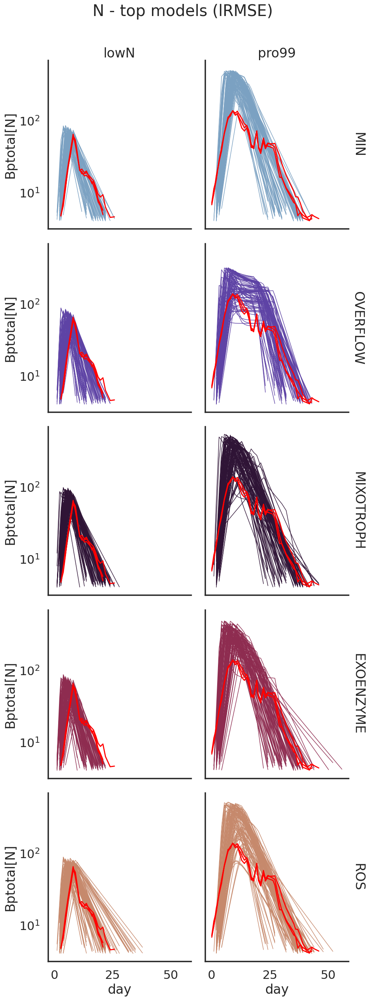

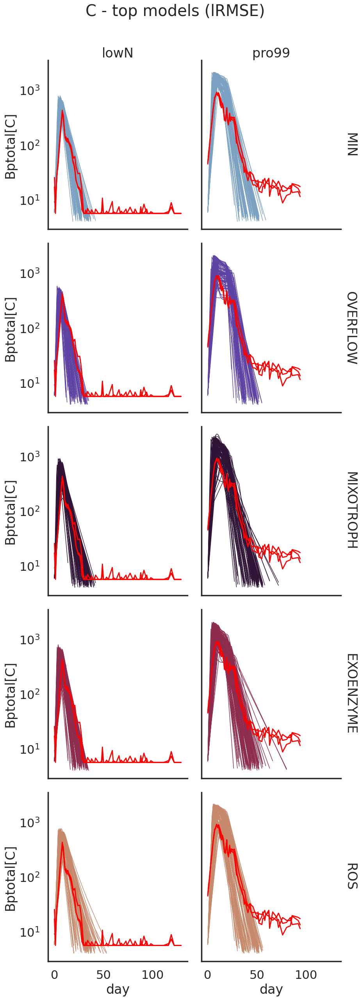

In [58]:
for n in ('N', 'C'):
    l= 'lRMSE'
    g = sns.relplot(
        data=df.loc[df[f'Bptotal[{n}]'].ge(4)],
        kind='line', 
        estimator=None, units='idx',
        x='day', y=f'Bptotal[{n}]', 
        col='media', col_order=media_order, lw=1,
        hue='model', hue_order=morder, palette=mpalette,
        row='model', row_order=morder, 
        facet_kws=dict( margin_titles=True),
        legend=False
    )
    for (row_val,col_val), ax in g.axes_dict.items():
        datadf = refdf if col_val == 'lowN' else refp99df
        sns.lineplot(
            data=datadf.loc[datadf[f'ref_Bp[{n}]'].ge(4)],
            x='day', y=f'ref_Bp[{n}]',
        units='Sample', estimator=None, ax=ax, lw=2, color='red',

                     legend=False
                    )
    g.set(yscale='log')
    g.set_titles(col_template='{col_name}', row_template='{row_name}')
    plt.suptitle(f'{n} - top models ({l})', y=1.03)

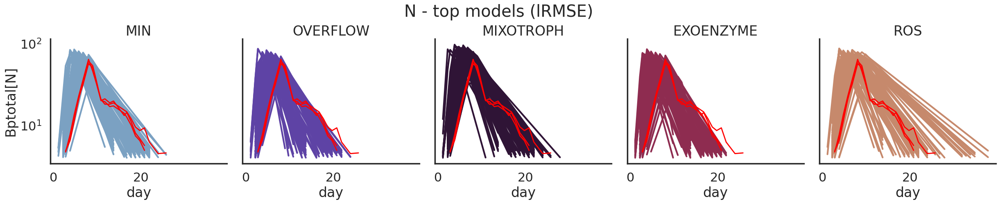

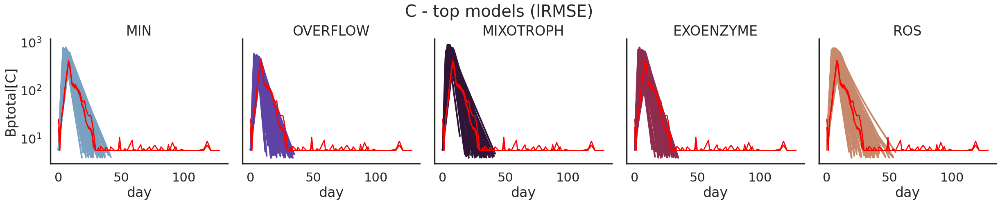

In [148]:
for n in ('N', 'C'):
    l= 'lRMSE'
    g = sns.relplot(
        data=df.loc[df[f'Bptotal[{n}]'].ge(4) & df.media.isin(['lowN'])],
        kind='line', 
        estimator=None, units='idx',
        x='day', y=f'Bptotal[{n}]', 
        #col='media', col_order=media_order, lw=1,
        hue='model', hue_order=morder, palette=mpalette,
        col='model', col_order=morder, 
        facet_kws=dict( margin_titles=True),
        legend=False
    )
    for (col_val), ax in g.axes_dict.items():
        datadf = refdf 
        sns.lineplot(
            data=datadf.loc[datadf[f'ref_Bp[{n}]'].ge(4)],
            x='day', y=f'ref_Bp[{n}]',
        units='Sample', estimator=None, ax=ax, lw=2, color='red',

                     legend=False
                    )
    g.set(yscale='log')
    g.set_titles(col_template='{col_name}', row_template='{row_name}')
    plt.suptitle(f'{n} - top models ({l})', y=1.03)

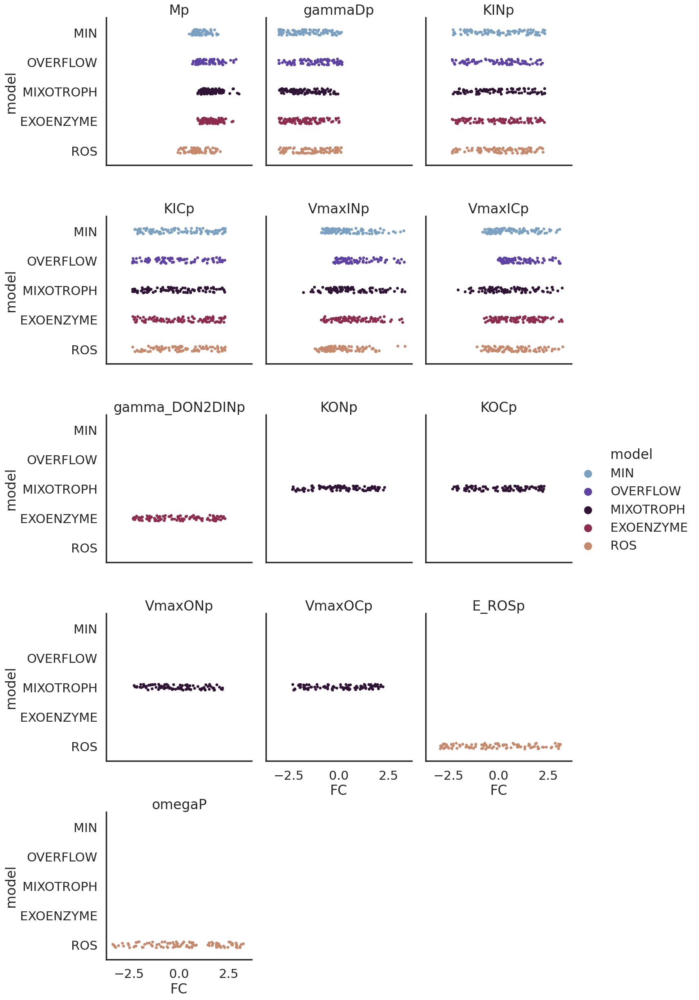

In [59]:
sns.set_context('poster')
sns.catplot(
    data=mparams_df.loc[~mparams_df['FC'].isna()].reset_index(), 
    col='variable', x='FC', y='model', col_wrap=3, order=morder,
    hue='model', hue_order=morder, palette=mpalette, 
).set_titles(col_template='{col_name}', row_template='{row_name}')

In [60]:
mparams_df.variable.unique()

array(['Mp', 'gammaDp', 'KINp', 'KICp', 'VmaxINp', 'VmaxICp',
       'gamma_DON2DINp', 'Mp_day', 'Vmax/K ICp', 'Vmax/K INp', 'R* INp',
       'R* ICp', 'Vmax/Vmax Ip', 'VmaxINp_day_cell', 'VmaxICp_day_cell',
       'gamma_DON2DINp_day_cell', 'KONp', 'KOCp', 'VmaxONp', 'VmaxOCp',
       'VmaxOCp_day_cell', 'VmaxONp_day_cell', 'E_ROSp', 'omegaP',
       'E_ROSp_day'], dtype=object)

In [61]:
variables_to_show_log = ['gammaDp', 'KINp', 'KICp',
      'Mp_day',  'VmaxINp_day_cell', 'VmaxICp_day_cell',
       'gamma_DON2DINp_day_cell', 'KONp', 'KOCp', 'VmaxONp', 'VmaxOCp',
       'VmaxOCp_day_cell', 'VmaxONp_day_cell', 'omegaP',
       'E_ROSp_day']

variables_to_show_nolog = ['Vmax/K ICp', 'Vmax/K INp', 'R* INp',
       'R* ICp', 'Vmax/Vmax Ip',]


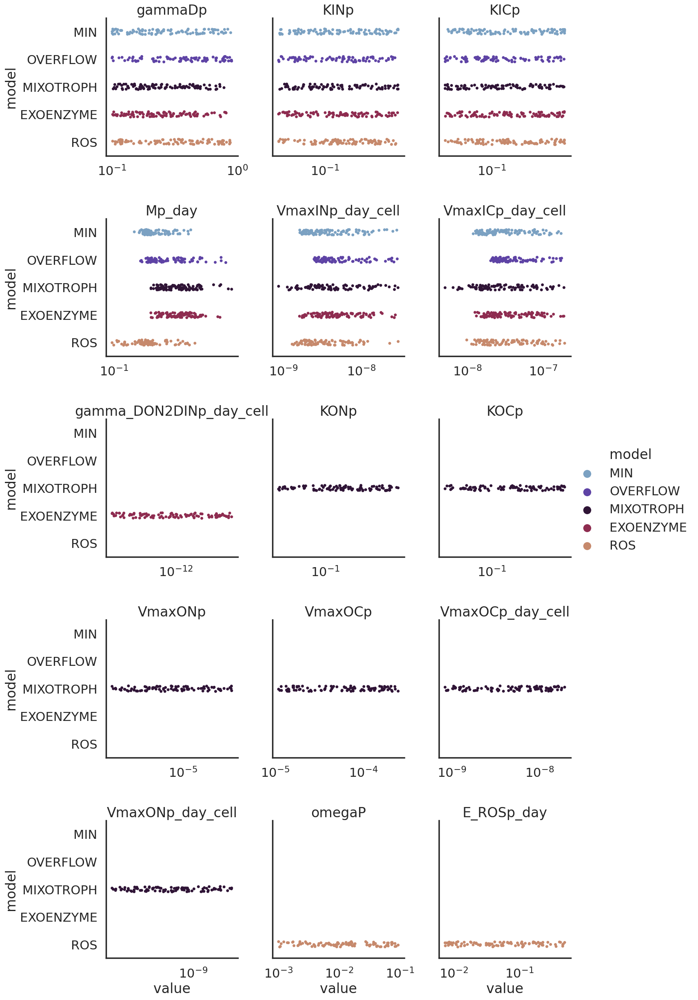

In [64]:
sns.set_context('poster')
sns.catplot(
    data=mparams_df.loc[mparams_df.variable.isin(variables_to_show_log)].reset_index(), 
    col='variable', x='value', y='model', col_wrap=3, order=morder,
    hue='model', hue_order=morder, palette=mpalette, sharex=False, 
    #facet_kws=dict(sharex=False, margin_titles=True),
).set_titles(col_template='{col_name}', row_template='{row_name}').set(xscale='log')


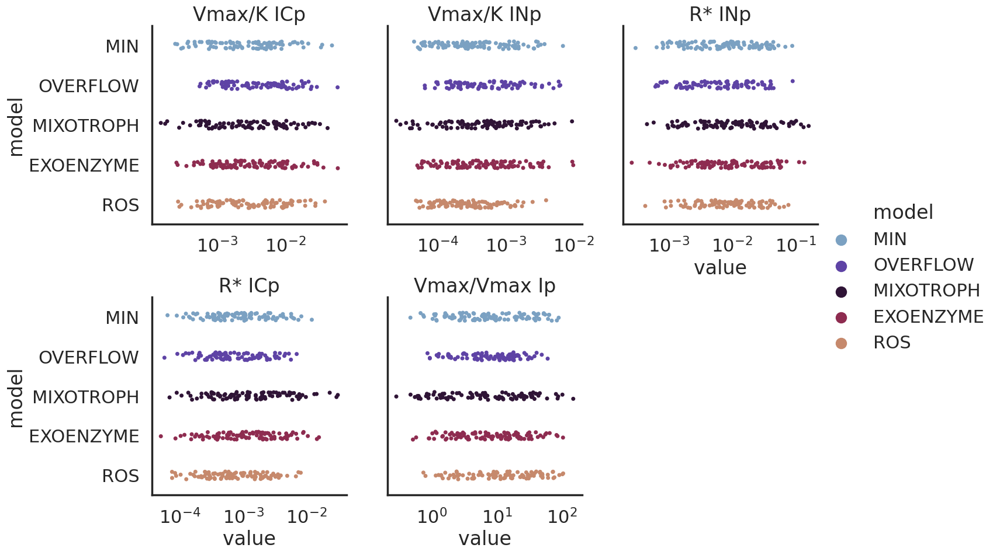

In [66]:
sns.set_context('poster')
sns.catplot(
    data=mparams_df.loc[mparams_df.variable.isin(variables_to_show_nolog)].reset_index(), 
    col='variable', x='value', y='model', col_wrap=3, order=morder,
    hue='model', hue_order=morder, palette=mpalette, sharex=False, 
    #facet_kws=dict(sharex=False, margin_titles=True),
).set_titles(col_template='{col_name}', row_template='{row_name}').set(xscale='log')



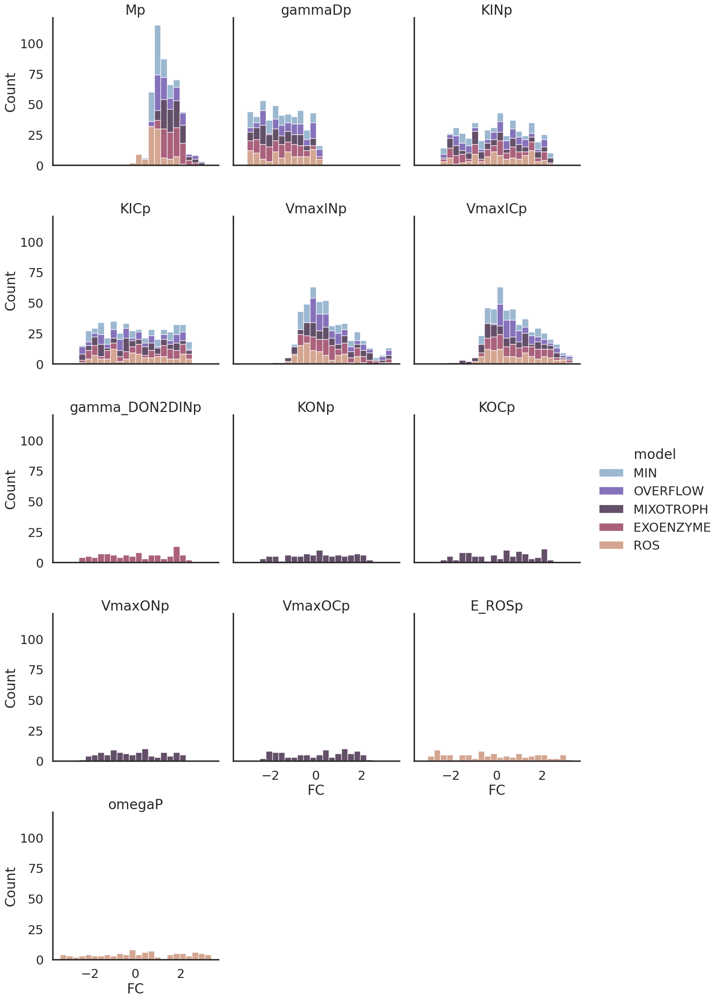

In [68]:
sns.set_context('poster')
sns.displot(
    data=mparams_df.loc[~mparams_df['FC'].isna()].reset_index(), 
    col='variable', x='FC',  col_wrap=3,
    hue='model', hue_order=morder, palette=mpalette, multiple='stack',
).set_titles(col_template='{col_name}', row_template='{row_name}')

In [69]:
df.columns

Index(['Bp', 'Np', 'Cp', 'DON', 'RDON', 'DIN', 'DOC', 'RDOC', 'DIC', 'ROS',
       't', 'day', 'gross_uptakeINp', 'gross_uptakeONp', 'gross_uptakeICp',
       'gross_uptakeOCp', 'uptakeNp', 'uptakeCp', 'QCp', 'biosynthesisNp',
       'respirationCp', 'biomass_breakdownCp', 'overflowNp', 'overflowCp',
       'Bp[C]', 'Bptotal[N]', 'Bptotal[C]', 'log_Bptotal[N]', 'log_Bptotal[C]',
       'run_id', 'id', 'media', 'which', 'model', 'hash', 'idx'],
      dtype='object')

In [70]:
mdf1 = df.melt(
    id_vars=['t', 'day', 'run_id', 'id', 'media', 'which', 'model', 'hash', 'idx'], 
    value_vars=var_names)

In [71]:
mdf2 = df.melt(
    id_vars=['t', 'day', 'run_id', 'id', 'media', 'which', 'model', 'hash', 'idx'], 
    value_vars=intermediate_names)

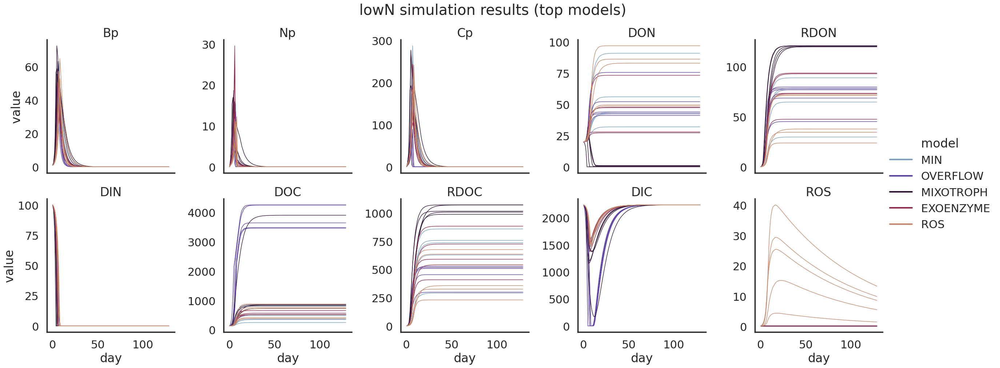

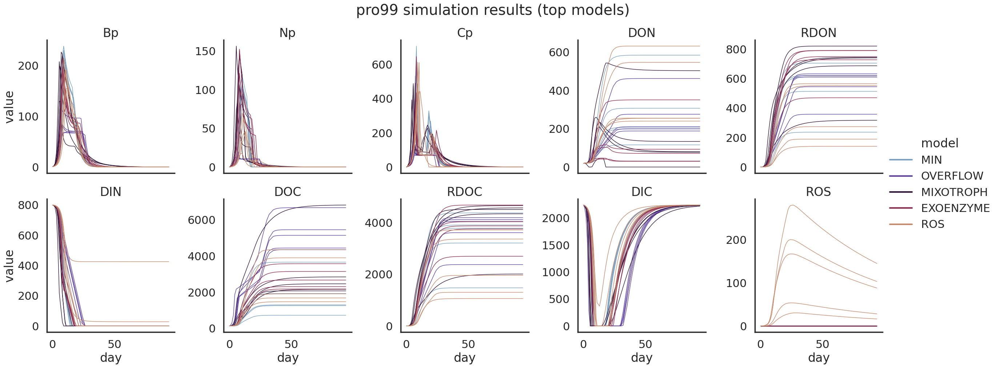

In [72]:
for med in media_order:
        rankcol = 'lrank'
        mrows = mean_scores.loc[mean_scores[rankcol].le(5)]

        g = sns.relplot(
            data=mdf1.loc[mdf1.idx.isin(mrows.idx) & mdf1.media.isin([med])],
            kind='line', 
            estimator=None, units='idx',
            x='day', y='value', 
            col='variable', lw=1, col_wrap=5,
            hue='model', hue_order=morder, palette=mpalette,
            facet_kws=dict( margin_titles=True, sharey=False),

        )
        g.set_titles(col_template='{col_name}', row_template='{row_name}')
        plt.suptitle(f'{med} simulation results (top models)', y=1.03)

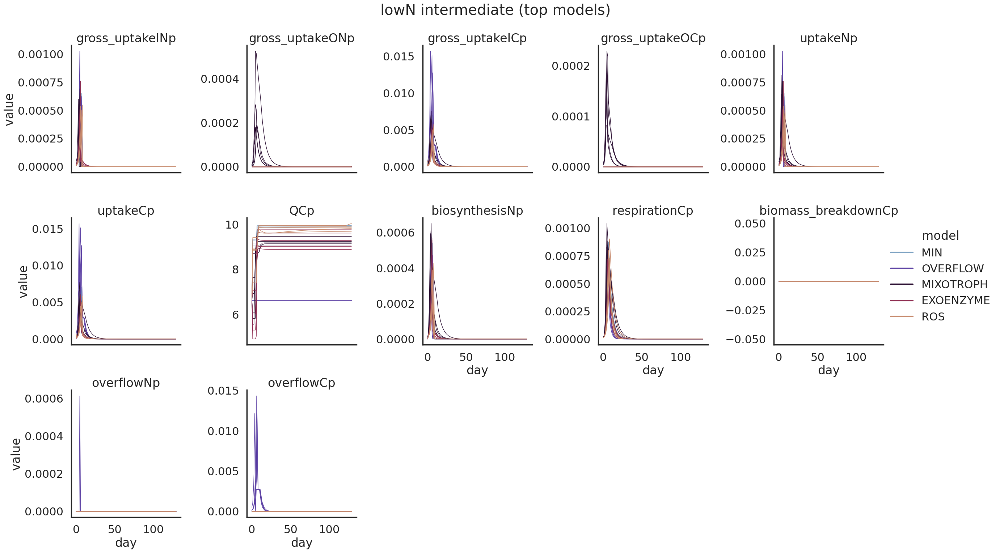

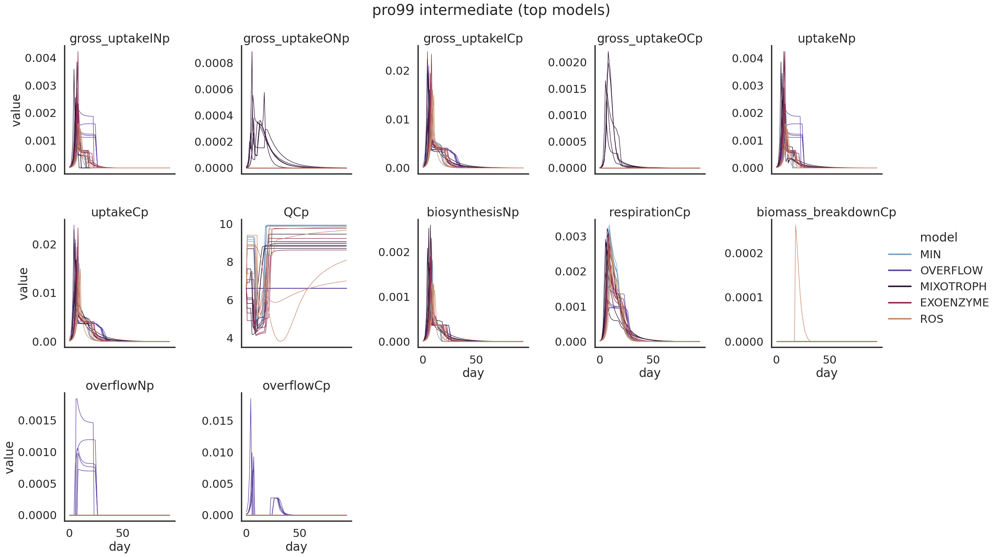

In [73]:
for med in media_order:
        rankcol = 'lrank'
        mrows = mean_scores.loc[mean_scores[rankcol].le(5)]

        g = sns.relplot(
            data=mdf2.loc[mdf2.idx.isin(mrows.idx) & mdf2.media.isin([med])],
            kind='line', 
            estimator=None, units='idx',
            x='day', y='value', 
            col='variable', lw=1, col_wrap=5,
            hue='model', hue_order=morder, palette=mpalette,
            facet_kws=dict( margin_titles=True, sharey=False),

        )
        g.set_titles(col_template='{col_name}', row_template='{row_name}')
        plt.suptitle(f'{med} intermediate (top models)', y=1.03)

Text(0.5, 1.03, 'C/N ratio (top models)')

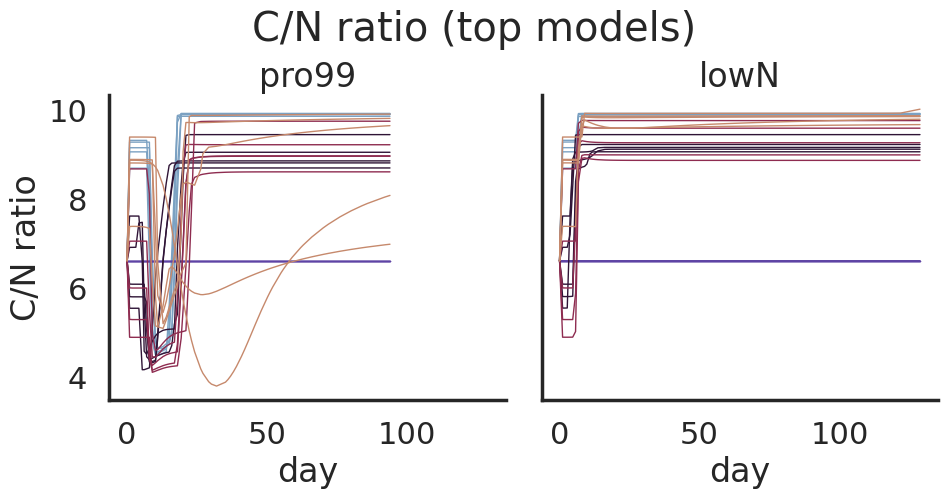

In [74]:
        rankcol = 'lrank'
        mrows = mean_scores.loc[mean_scores[rankcol].le(5)]

        g = sns.relplot(
            data=mdf2.loc[mdf2.idx.isin(mrows.idx) & mdf2.variable.isin(['QCp'])],
            kind='line', 
            estimator=None, units='idx',
            x='day', y='value', 
            col='media', lw=1, #col_wrap=5,
            hue='model', hue_order=morder, palette=mpalette,
            #facet_kws=dict( margin_titles=True, sharey=False),
            legend=False,

        )
        g.set_titles(col_template='{col_name}', row_template='{row_name}')
        g.set(ylabel='C/N ratio')
        plt.suptitle(f'C/N ratio (top models)', y=1.03)

Text(0.5, 1.03, 'C/N ratio (top models)')

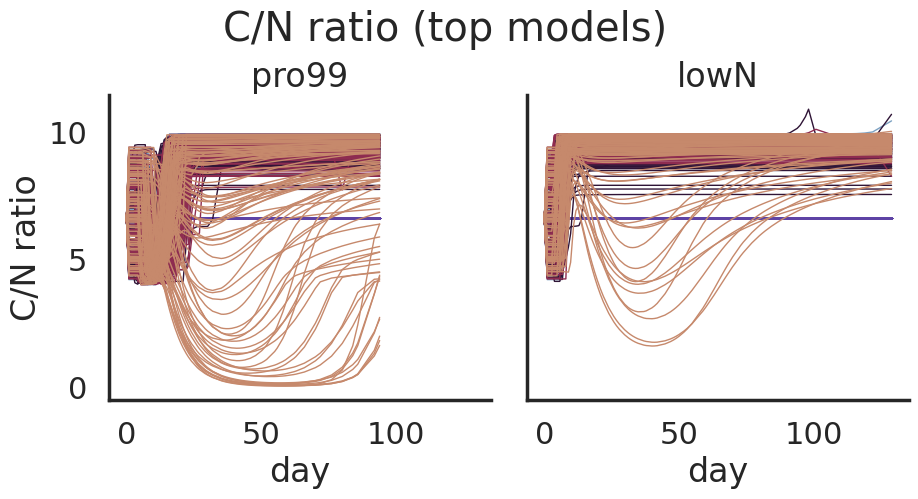

In [75]:
        rankcol = 'lrank'
        mrows = mean_scores.loc[mean_scores[rankcol].le(5)]

        g = sns.relplot(
            data=mdf2.loc[mdf2.variable.isin(['QCp'])],
            kind='line', 
            estimator=None, units='idx',
            x='day', y='value', 
            col='media', lw=1, #col_wrap=5,
            hue='model', hue_order=morder, palette=mpalette,
            #facet_kws=dict( margin_titles=True, sharey=False),
            legend=False,

        )
        g.set_titles(col_template='{col_name}', row_template='{row_name}')
        g.set(ylabel='C/N ratio')
        plt.suptitle(f'C/N ratio (top models)', y=1.03)

In [76]:
    min_params_to_update, _, _ = get_param_tuning_values('MIN', organism_to_tune)


__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.xlsx


In [77]:
from scipy.stats import pearsonr

def corrfunc(x, y, ax=None, **kws):
    """Plot the correlation coefficient in the top left hand corner of a plot."""
    r, _ = pearsonr(x, y)
    ax = ax or plt.gca()
    ax.annotate(f'ρ = {r:.2f}', xy=(.1, .9), xycoords=ax.transAxes)

In [78]:
def _get_corrs(model):
    mrows = min_rows 
    cur_params_to_update, _, _ = get_param_tuning_values(model, organism_to_tune)

    tmp = mparams_df.loc[
                    mparams_df.idx.isin(mrows.idx) &
                    mparams_df.model.isin([model]) 
                ]

    mtmp = tmp.pivot_table(index='idx', columns='variable', values='FC')[cur_params_to_update]
    corr_df = mtmp.corr()
    trimask = np.triu(np.ones_like(corr_df, dtype=bool))    
    corr_unstack = corr_df.mask(trimask).unstack().dropna()
    res_df = corr_unstack.rename_axis(['var1', 'var2']).reset_index().rename(columns={0:'correlation'})
    res_df['model'] = model
    return res_df
corr_df = pd.concat([_get_corrs(m) for m in morder ], ignore_index=True)
corr_df

__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.xlsx
__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.xlsx
__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.xlsx
__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.xlsx
__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.

,var1,var2,correlation,model
0,Mp,gammaDp,-0.063279,MIN
1,Mp,KINp,-0.031920,MIN
2,Mp,KICp,-0.199223,MIN
3,Mp,VmaxINp,-0.155600,MIN
4,Mp,VmaxICp,0.416205,MIN
...,...,...,...,...
119,VmaxINp,E_ROSp,-0.163464,ROS
120,VmaxINp,omegaP,-0.108072,ROS
121,VmaxICp,E_ROSp,0.031294,ROS
122,VmaxICp,omegaP,-0.095787,ROS


In [79]:
corr_df['pair'] = corr_df.var1 +' / ' +  corr_df.var2

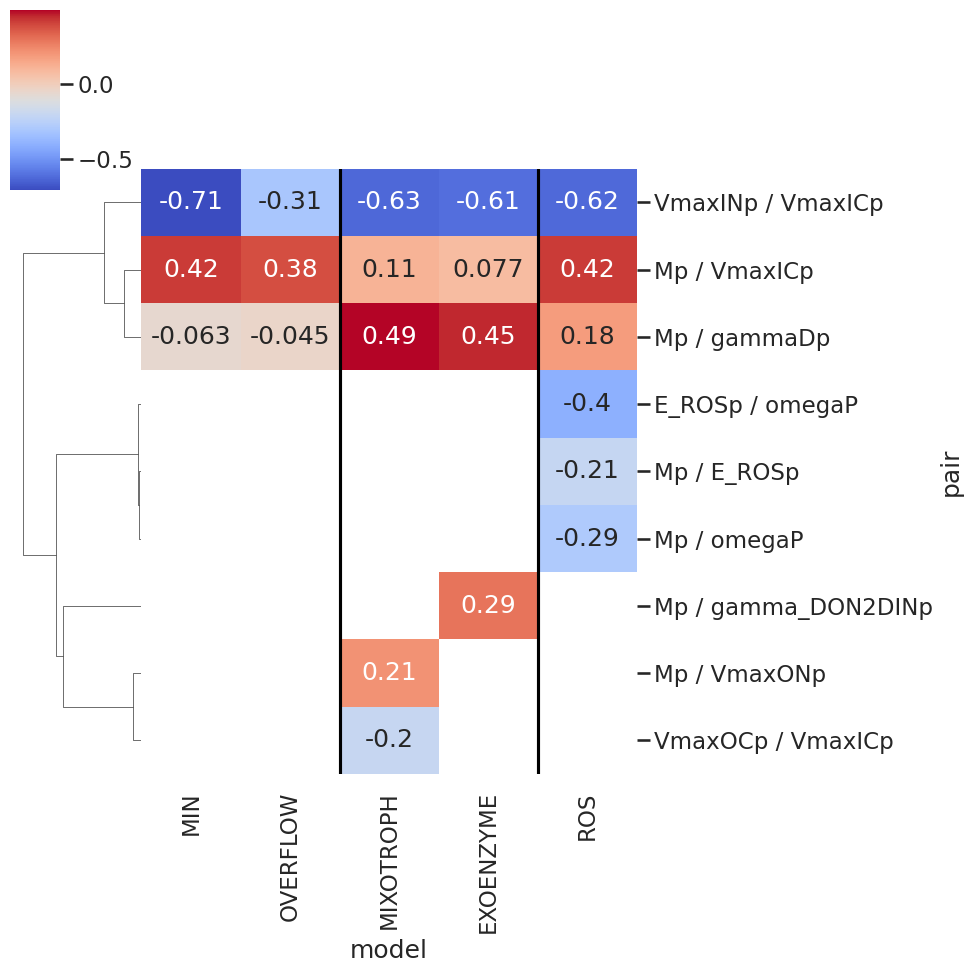

In [80]:
corr_df_filtered = corr_df.loc[(corr_df.correlation > 0.2) | (corr_df.correlation < -0.2)]

pcorr_df = corr_df.loc[corr_df.pair.isin(corr_df_filtered.pair)].pivot_table(index='pair', columns=['model',  ], 
                               values='correlation', fill_value=3, dropna=True)
pcorr_df = pcorr_df.reindex(columns=pcorr_df.columns.reindex(morder, level=0)[0])
sns.set_context('talk')

g = sns.clustermap(
    pcorr_df, 
    cmap='coolwarm', 
    mask=pcorr_df==3,
    col_cluster=False,
    annot=True,
    
)
ax = g.ax_heatmap  
for i in [2,4,6,8]:
    ax.axvline(i, c='black')


In [97]:
mparams_df.variable.unique()

array(['Mp', 'gammaDp', 'KINp', 'KICp', 'VmaxINp', 'VmaxICp',
       'gamma_DON2DINp', 'Mp_day', 'Vmax/K ICp', 'Vmax/K INp', 'R* INp',
       'R* ICp', 'Vmax/Vmax Ip', 'VmaxINp_day_cell', 'VmaxICp_day_cell',
       'gamma_DON2DINp_day_cell', 'KONp', 'KOCp', 'VmaxONp', 'VmaxOCp',
       'VmaxOCp_day_cell', 'VmaxONp_day_cell', 'E_ROSp', 'omegaP',
       'E_ROSp_day'], dtype=object)

In [99]:
additional_variables

['Vmax/K ICp', 'Vmax/K INp', 'R* INp', 'R* ICp', 'Vmax/Vmax Ip']

In [98]:
min_params_to_update

['Mp', 'gammaDp', 'KINp', 'KICp', 'VmaxINp', 'VmaxICp']

__file__, /fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/model_equations_separate_NC_store_numba.py
/fast_data/Osnat/RECYCLE_MODEL/recycle_model/STORE_model/Model_Parameters Store model.xlsx


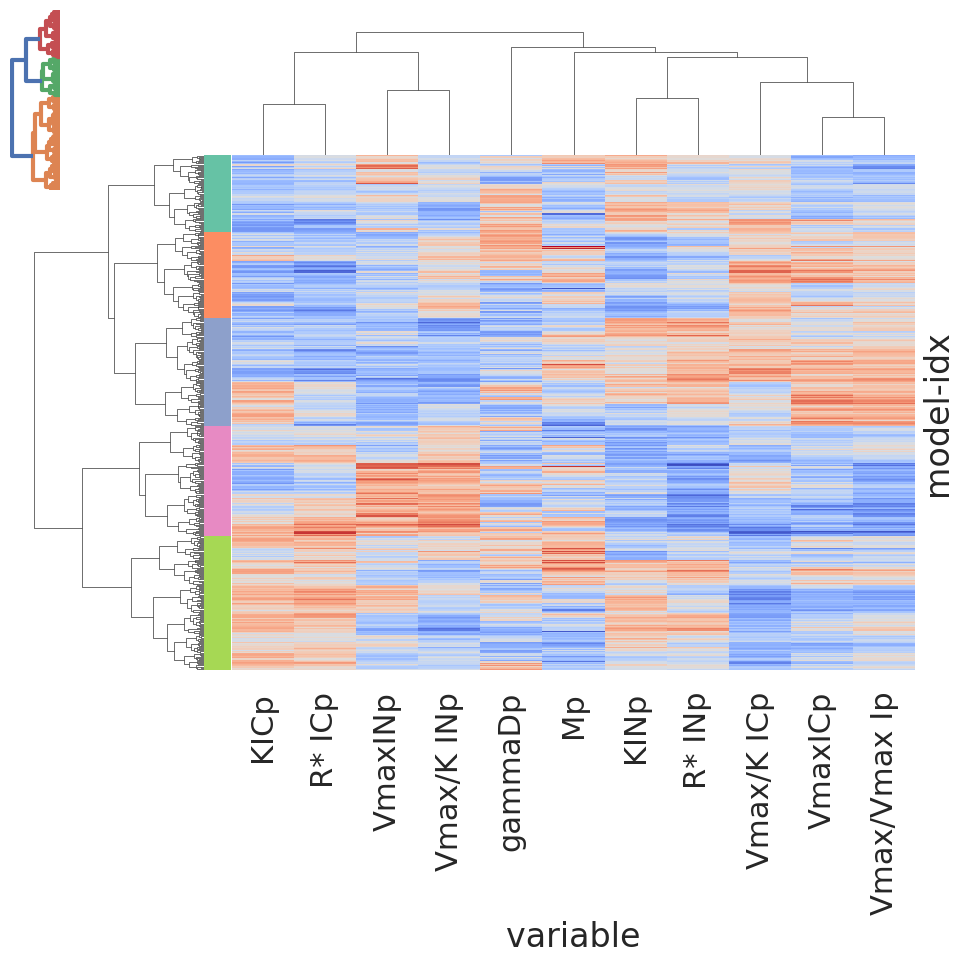

In [137]:
from scipy.cluster.vq import whiten
from scipy.cluster.hierarchy import fcluster, linkage
from sklearn.preprocessing import StandardScaler
from scipy.cluster.hierarchy import dendrogram

#def _get_clusters(model):
model='MIN'
cur_params_to_update, _, _ = get_param_tuning_values(model, organism_to_tune)

variables = cur_params_to_update + additional_variables

mtmp = mparams_df.pivot_table(index=['model','idx'], columns='variable', values='value')[variables]
mtmp
mtmp = np.log2(mtmp)
mtmp_transformed = ((mtmp - mtmp.mean()) / mtmp.std())
# # standardize (normalize) the features
data = whiten(mtmp_transformed)

# Compute the distance matrix
matrix = linkage(
    data,
    method='ward',
    #method='single',
    #method='centroid',
    #method='complete',
    metric='euclidean'
    )

# Assign cluster labels
labels = fcluster(
    matrix, 5, 
    criterion='maxclust'
    )
labels_series = pd.Series(labels, index= mtmp.index.get_level_values(1))
mparams_df['cluster'] = mparams_df.idx.map(labels_series)

lut = dict(zip(np.unique(labels), sns.color_palette('Set2', n_colors=np.max(labels)+1).as_hex()))
row_colors = np.vectorize(lut.get)(labels) 
sns.clustermap(
    data=mtmp_transformed, #col_cluster=False, 
    row_linkage=matrix, 
    cmap='coolwarm',
    row_colors=row_colors,
    yticklabels=False,
              )

dendrogram(matrix, no_labels=True, orientation='left')
plt.show()
# Create DataFrame
#mtmp['labels'] = labels
    
#mtmp = _get_clusters('MIN')
# corr_df = pd.concat([_get_corrs(m,l) for m in morder for l in ('RMSE', 'lRMSE')], ignore_index=True)
# corr_df

,idx,model,variable,value
0,vpro_31007_EXOENZYME,EXOENZYME,Mp,-18.646285
1,vpro_3119_EXOENZYME,EXOENZYME,Mp,-18.344176
2,vpro_3135_EXOENZYME,EXOENZYME,Mp,-18.211025
3,vpro_3151_EXOENZYME,EXOENZYME,Mp,-18.511086
4,vpro_3163_EXOENZYME,EXOENZYME,Mp,-18.769733
...,...,...,...,...
5264,vpro_4915_ROS,ROS,Vmax/Vmax Ip,4.092182
5265,vpro_4917_ROS,ROS,Vmax/Vmax Ip,2.493933
5266,vpro_4928_ROS,ROS,Vmax/Vmax Ip,6.696161
5267,vpro_4933_ROS,ROS,Vmax/Vmax Ip,1.157461


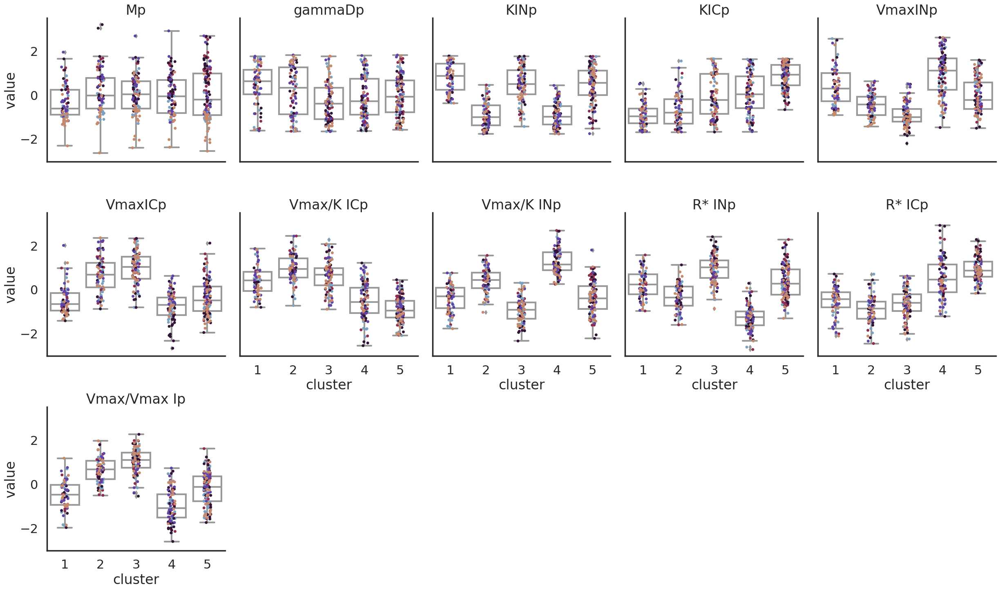

In [139]:
mtmp1 = mtmp_transformed.copy()
mtmp1['cluster'] = labels
mtmp_melt = mtmp1.reset_index().melt(id_vars=['idx', 'model', 'cluster'])
sns.set_context('poster')
g = sns.catplot(
    data=mtmp_melt, 
    col='variable', y='value', x='cluster', #fill=None,#hue='cluster', #col_wrap=3,
    #hue='model', hue_order=morder, palette=mpalette, #multiple='stack',
    kind='box', dodge=False, col_wrap=5,color='white',
    facet_kws=dict(sharey=False, margin_titles=True),
    
).set_titles(col_template='{col_name}', row_template='{row_name}')
g.map_dataframe(sns.stripplot, y='value', x='cluster', 
    hue='model', hue_order=morder, palette=mpalette, #multiple='stack',
     )


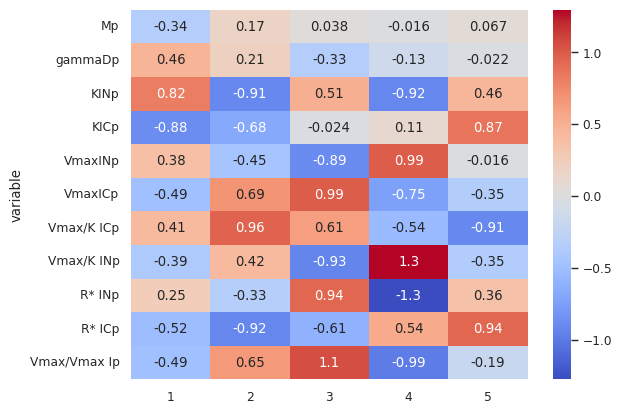

In [146]:
sns.set_context('paper')
sns.heatmap(mtmp_transformed.groupby(labels).mean().T, annot=True, cmap='coolwarm')
sns.set_context('poster')


In [82]:
labels_series = pd.Series(labels, index= mtmp.index.get_level_values(1))

In [83]:
labels_series = pd.Series(labels, index= mtmp.index.get_level_values(1))
mparams_df['cluster'] = mparams_df.idx.map(labels_series)

In [84]:
mparams_df['cluster'].value_counts()

1    2487
5    1521
4    1431
3    1361
2     973
Name: cluster, dtype: int64

In [85]:
mtmp

variable                              Mp   gammaDp      KINp      KICp  \
model     idx                                                            
EXOENZYME vpro_31007_EXOENZYME  1.074387 -1.667131 -0.212622  2.037652   
          vpro_3119_EXOENZYME   1.376496 -2.902618  0.786193  0.017882   
          vpro_3135_EXOENZYME   1.509647 -2.744857  1.913497 -0.877277   
          vpro_3151_EXOENZYME   1.209586 -1.951217  0.277264  2.132982   
          vpro_3163_EXOENZYME   0.950938 -2.569327  2.210485 -1.222381   
...                                  ...       ...       ...       ...   
ROS       vpro_4915_ROS         0.771473 -2.729423  1.279634  0.800230   
          vpro_4917_ROS         0.849179 -1.789426 -0.898710  0.382518   
          vpro_4928_ROS         0.350521 -0.942844 -0.111912  1.374937   
          vpro_4933_ROS         0.629194 -0.464128  2.063635 -0.960266   
          vpro_4987_ROS        -0.050619 -2.866191 -0.536909 -1.238038   

variable                         VmaxINp   VmaxICp  
model     idx                                       
EXOENZYME vpro_31007_EXOENZYME -0.072354  0.927989  
          vpro_3119_EXOENZYME   0.742013 -0.204999  
          vpro_3135_EXOENZYME   0.290096  1.220934  
          vpro_3151_EXOENZYME   1.968650 -0.711537  
          vpro_3163_EXOENZYME   1.754670 -0.288727  
...                                  ...       ...  
ROS       vpro_4915_ROS        -0.629407  0.655420  
          vpro_4917_ROS         0.255590 -0.057832  
          vpro_4928_ROS        -1.063996  2.824810  
          vpro_4933_ROS         1.032684 -0.617210  
          vpro_4987_ROS        -0.773412  0.274116  

[479 rows x 6 columns]

kmeans.labels_

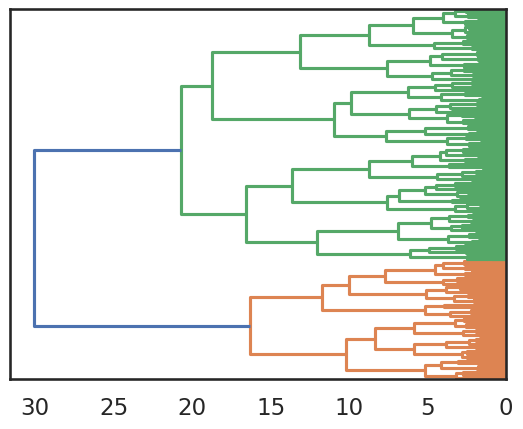

In [86]:
from scipy.cluster.hierarchy import dendrogram

dendrogram(matrix, no_labels=True, orientation='left')
plt.show()

In [87]:
lut = dict(zip(np.unique(labels), sns.color_palette('Set2', n_colors=np.max(labels)+1).as_hex()))
row_colors = np.vectorize(lut.get)(labels) 


In [88]:
mtmp

variable                              Mp   gammaDp      KINp      KICp  \
model     idx                                                            
EXOENZYME vpro_31007_EXOENZYME  1.074387 -1.667131 -0.212622  2.037652   
          vpro_3119_EXOENZYME   1.376496 -2.902618  0.786193  0.017882   
          vpro_3135_EXOENZYME   1.509647 -2.744857  1.913497 -0.877277   
          vpro_3151_EXOENZYME   1.209586 -1.951217  0.277264  2.132982   
          vpro_3163_EXOENZYME   0.950938 -2.569327  2.210485 -1.222381   
...                                  ...       ...       ...       ...   
ROS       vpro_4915_ROS         0.771473 -2.729423  1.279634  0.800230   
          vpro_4917_ROS         0.849179 -1.789426 -0.898710  0.382518   
          vpro_4928_ROS         0.350521 -0.942844 -0.111912  1.374937   
          vpro_4933_ROS         0.629194 -0.464128  2.063635 -0.960266   
          vpro_4987_ROS        -0.050619 -2.866191 -0.536909 -1.238038   

variable                         VmaxINp   VmaxICp  
model     idx                                       
EXOENZYME vpro_31007_EXOENZYME -0.072354  0.927989  
          vpro_3119_EXOENZYME   0.742013 -0.204999  
          vpro_3135_EXOENZYME   0.290096  1.220934  
          vpro_3151_EXOENZYME   1.968650 -0.711537  
          vpro_3163_EXOENZYME   1.754670 -0.288727  
...                                  ...       ...  
ROS       vpro_4915_ROS        -0.629407  0.655420  
          vpro_4917_ROS         0.255590 -0.057832  
          vpro_4928_ROS        -1.063996  2.824810  
          vpro_4933_ROS         1.032684 -0.617210  
          vpro_4987_ROS        -0.773412  0.274116  

[479 rows x 6 columns]

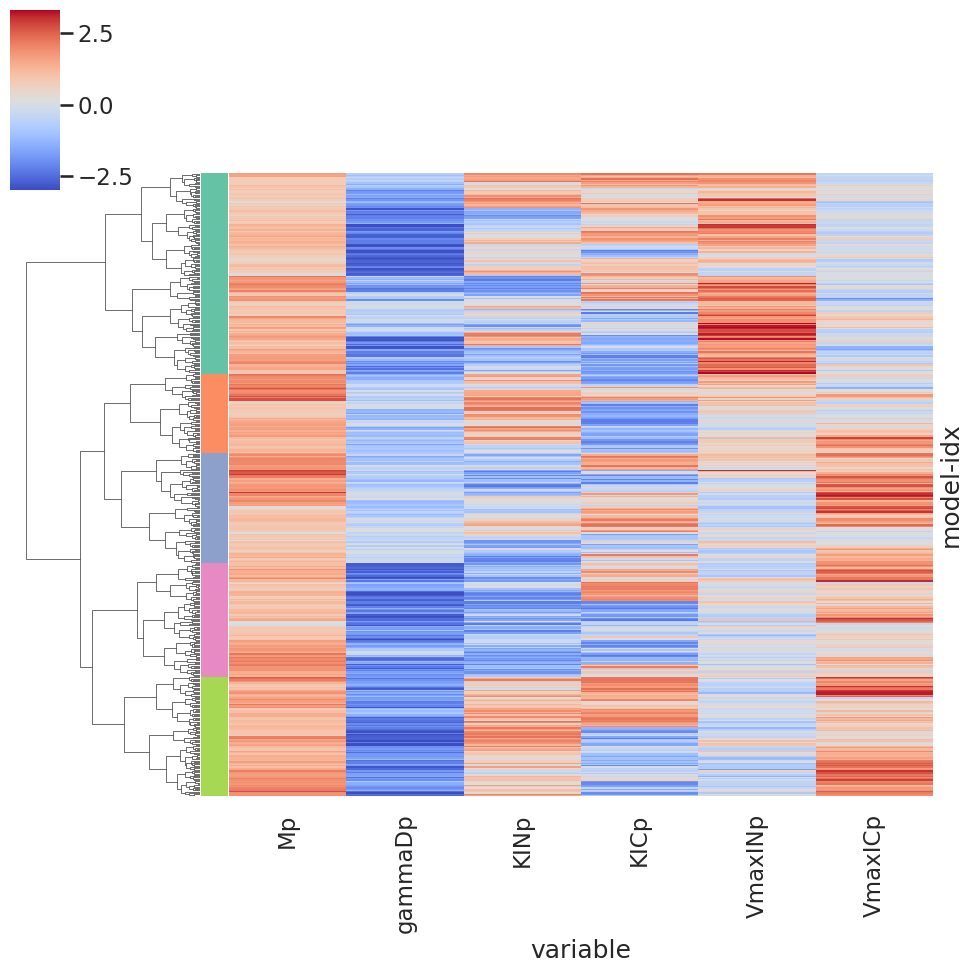

In [89]:
sns.clustermap(
    data=mtmp, col_cluster=False, row_linkage=matrix, 
    cmap='coolwarm',
    row_colors=row_colors,
    yticklabels=False,
              )

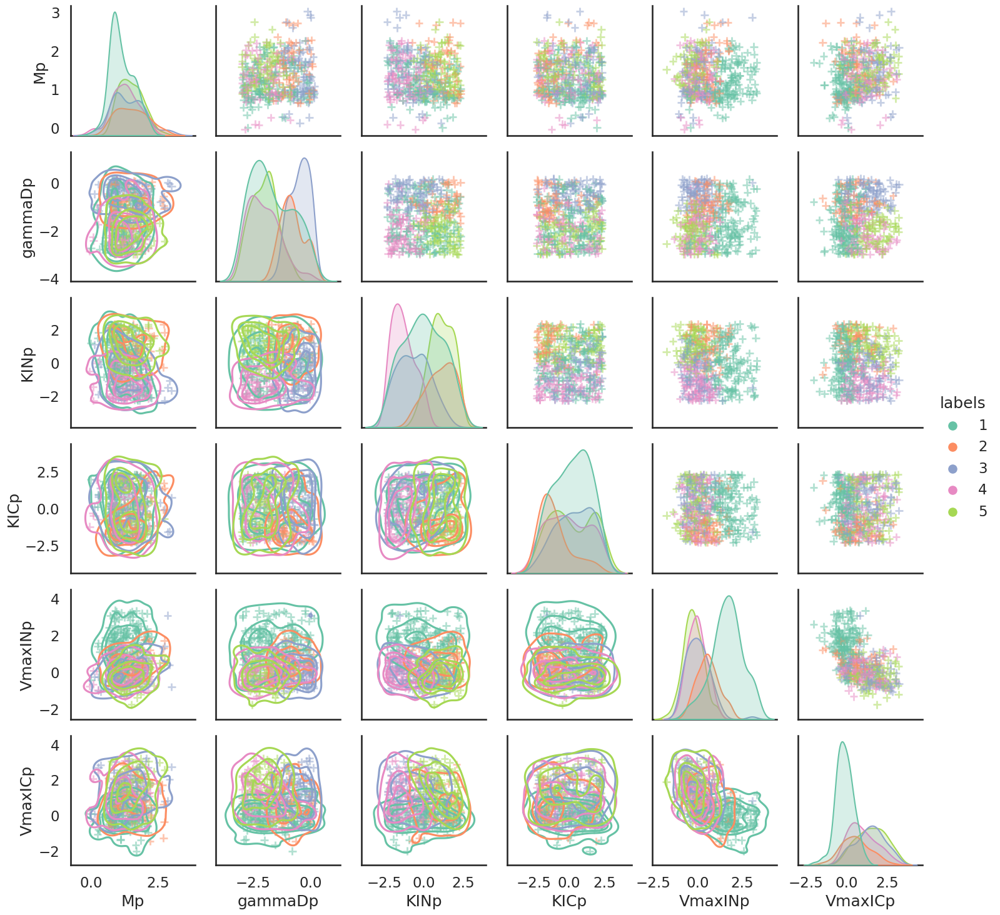

In [90]:
mtmp1 = mtmp.copy()
mtmp1['labels'] = labels
mtmp1.reset_index(inplace=True)
g = sns.pairplot(
    data=mtmp1, hue='labels', palette='Set2',
    plot_kws=dict(marker="+", linewidth=2, alpha=0.5),
)
g.map_lower(sns.kdeplot, levels=4)


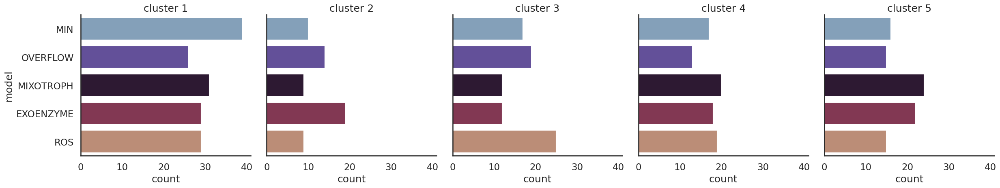

In [91]:
sns.catplot(
    data=mtmp1,
    col='labels', 
    y='model', hue='model', hue_order=morder, order=morder, palette=mpalette,dodge=False,
    kind='count',
    legend=False,
).set_titles(col_template='cluster {col_name}', row_template='{row_name}')

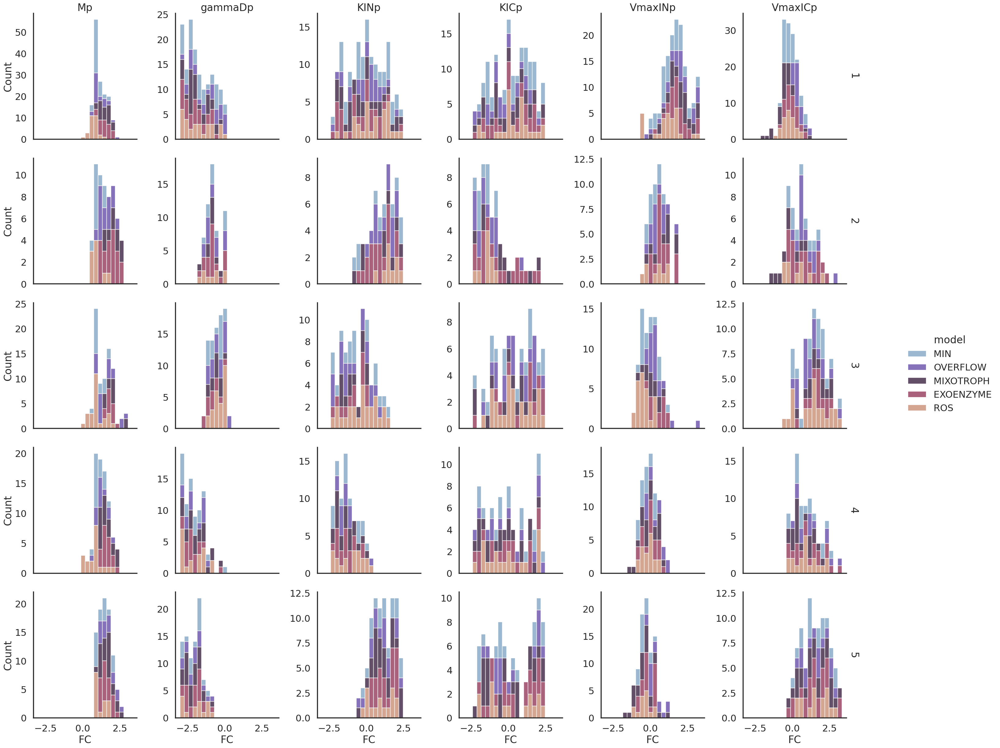

In [92]:
sns.set_context('poster')
sns.displot(
    data=mparams_df.loc[~mparams_df['cluster'].isna() & mparams_df.variable.isin(min_params_to_update)], 
    col='variable', row='cluster', x='FC',  #col_wrap=3,
    hue='model', hue_order=morder, palette=mpalette, multiple='stack',
    facet_kws=dict(sharey=False, margin_titles=True),
    
).set_titles(col_template='{col_name}', row_template='{row_name}')

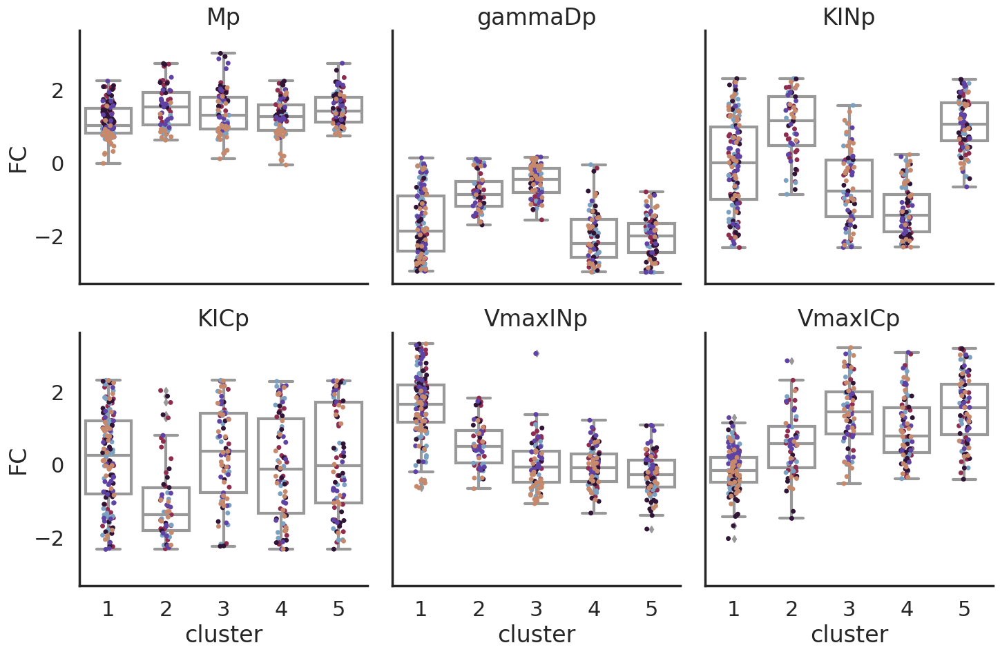

In [93]:
sns.set_context('poster')
g = sns.catplot(
    data=mparams_df.loc[~mparams_df['cluster'].isna() & mparams_df.variable.isin(min_params_to_update)], 
    col='variable', y='FC', x='cluster', #fill=None,#hue='cluster', #col_wrap=3,
    #hue='model', hue_order=morder, palette=mpalette, #multiple='stack',
    kind='box', dodge=False, col_wrap=3,color='white',
    facet_kws=dict(sharey=False, margin_titles=True),
    
).set_titles(col_template='{col_name}', row_template='{row_name}')
g.map_dataframe(sns.stripplot, y='FC', x='cluster', 
    hue='model', hue_order=morder, palette=mpalette, #multiple='stack',
     )


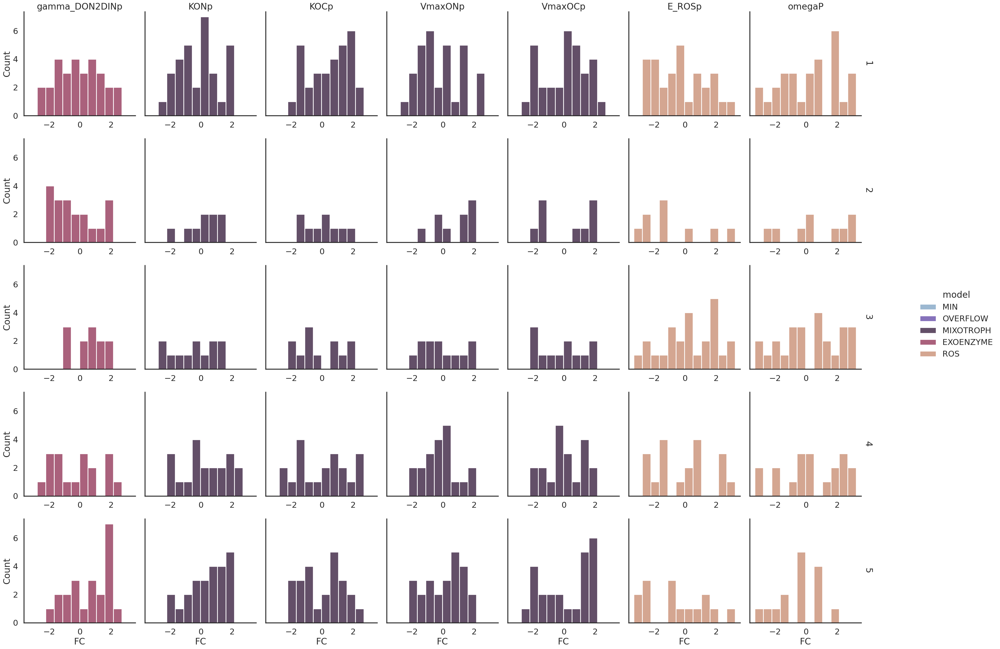

In [95]:
sns.set_context('poster')
sns.displot(
    data=mparams_df.loc[~mparams_df['cluster'].isna() & 
                        ~mparams_df.variable.isin(min_params_to_update) &
                        ~mparams_df.FC.isna()
                       ], 
    col='variable', row='cluster', x='FC',  #col_wrap=3,
    hue='model', hue_order=morder, palette=mpalette, multiple='stack',
    facet_kws=dict(sharex=False, margin_titles=True),
).set_titles(col_template='{col_name}', row_template='{row_name}')

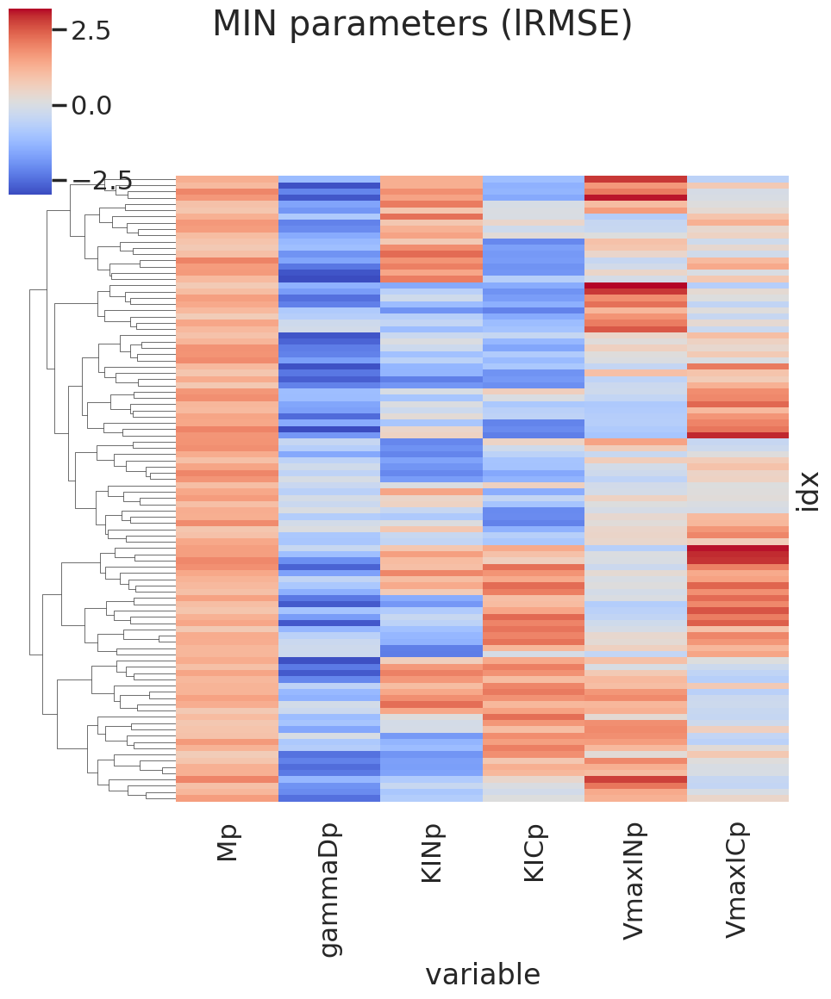

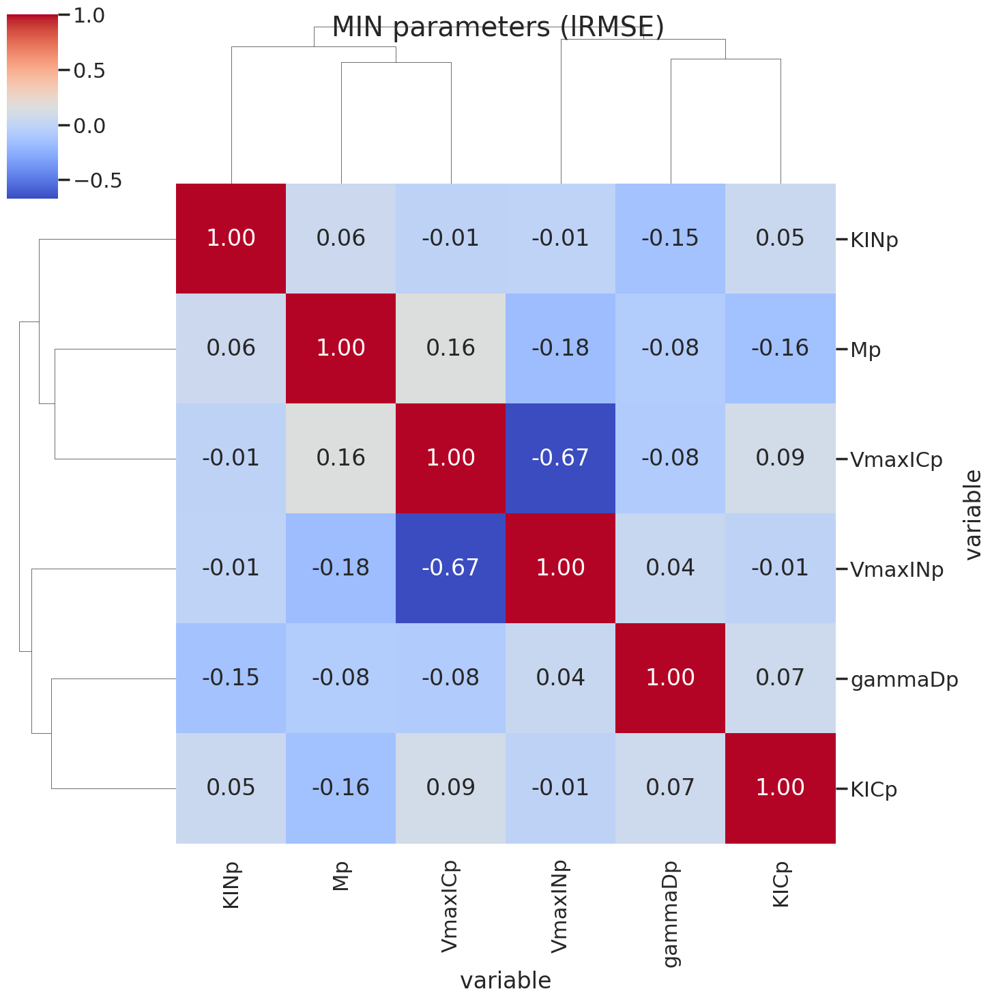

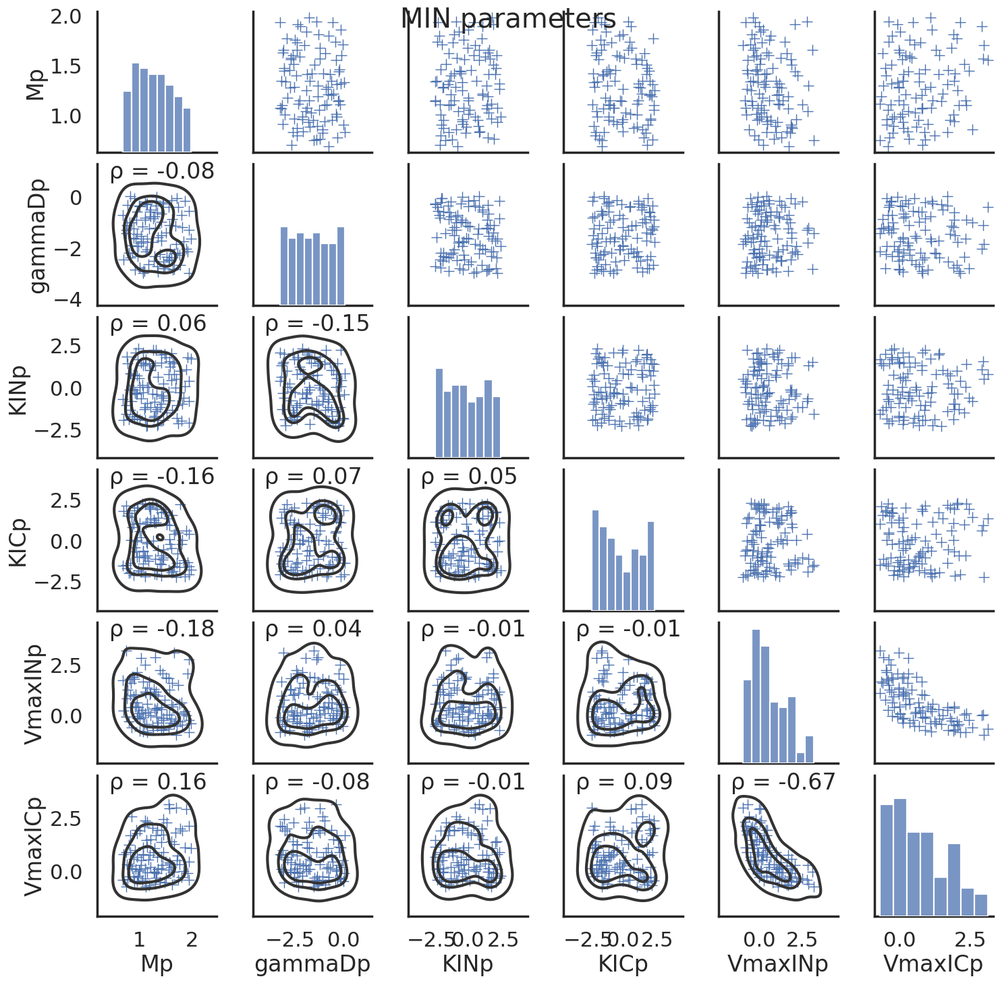

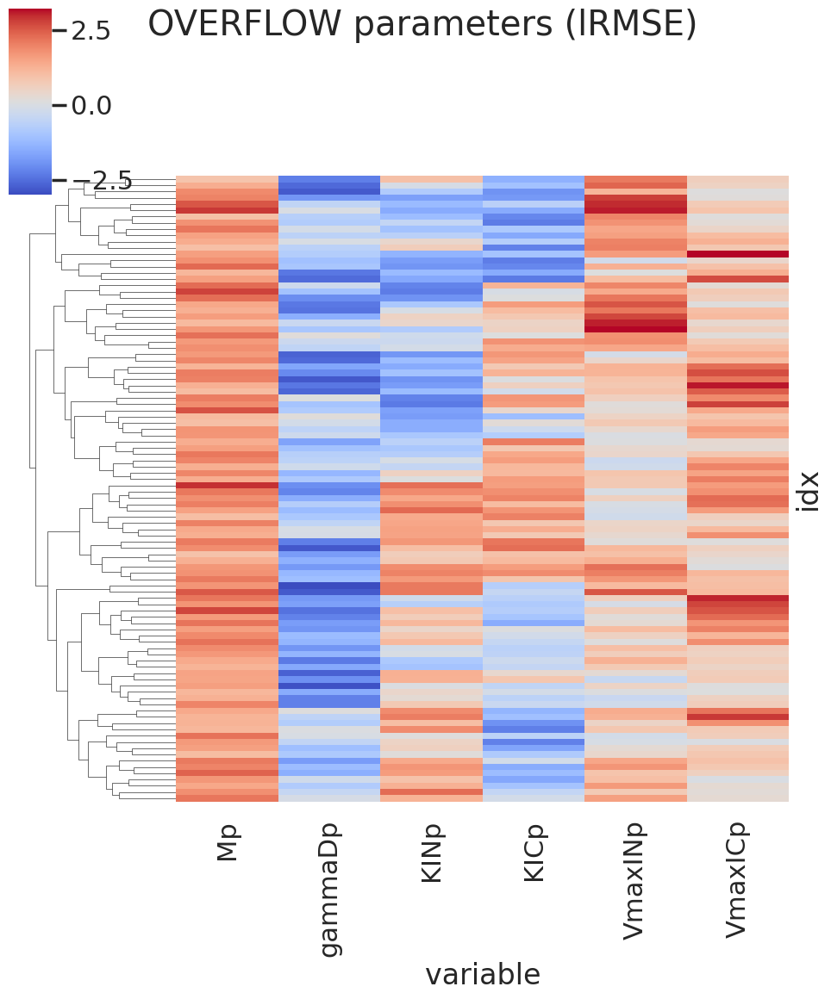

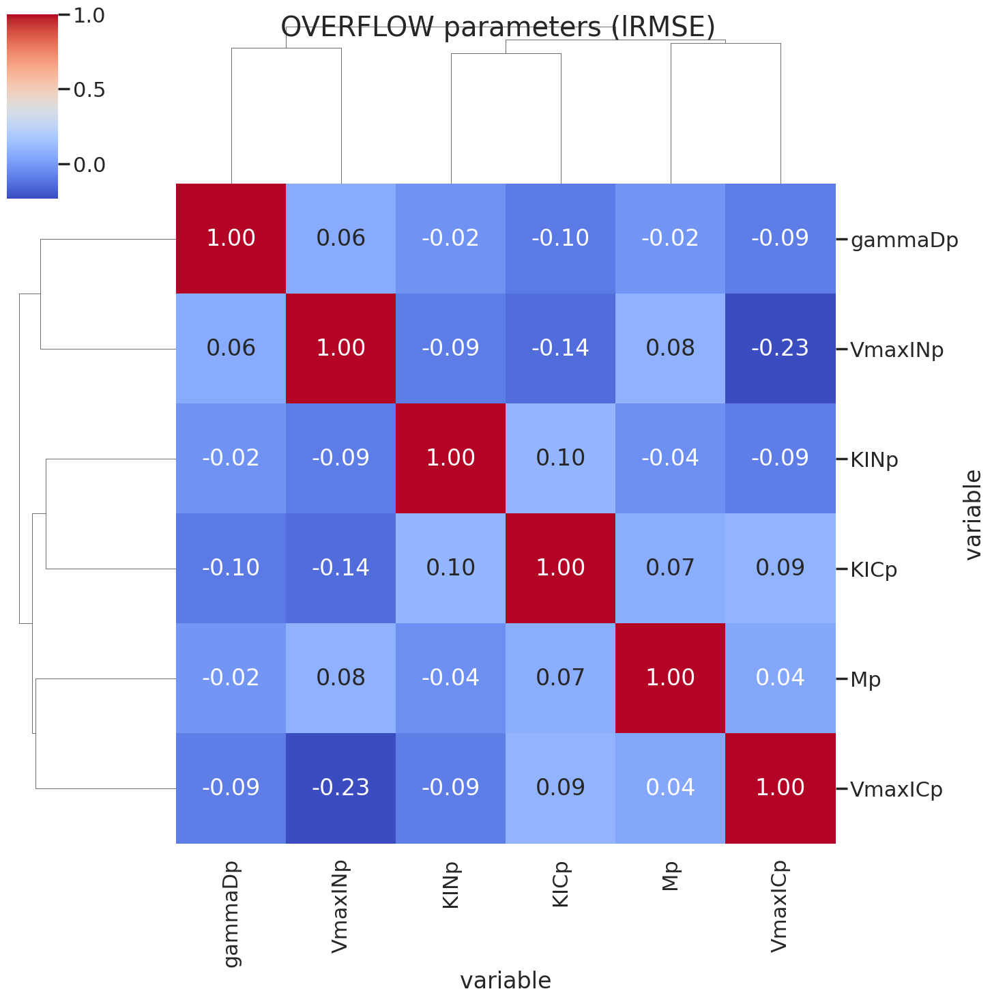

...

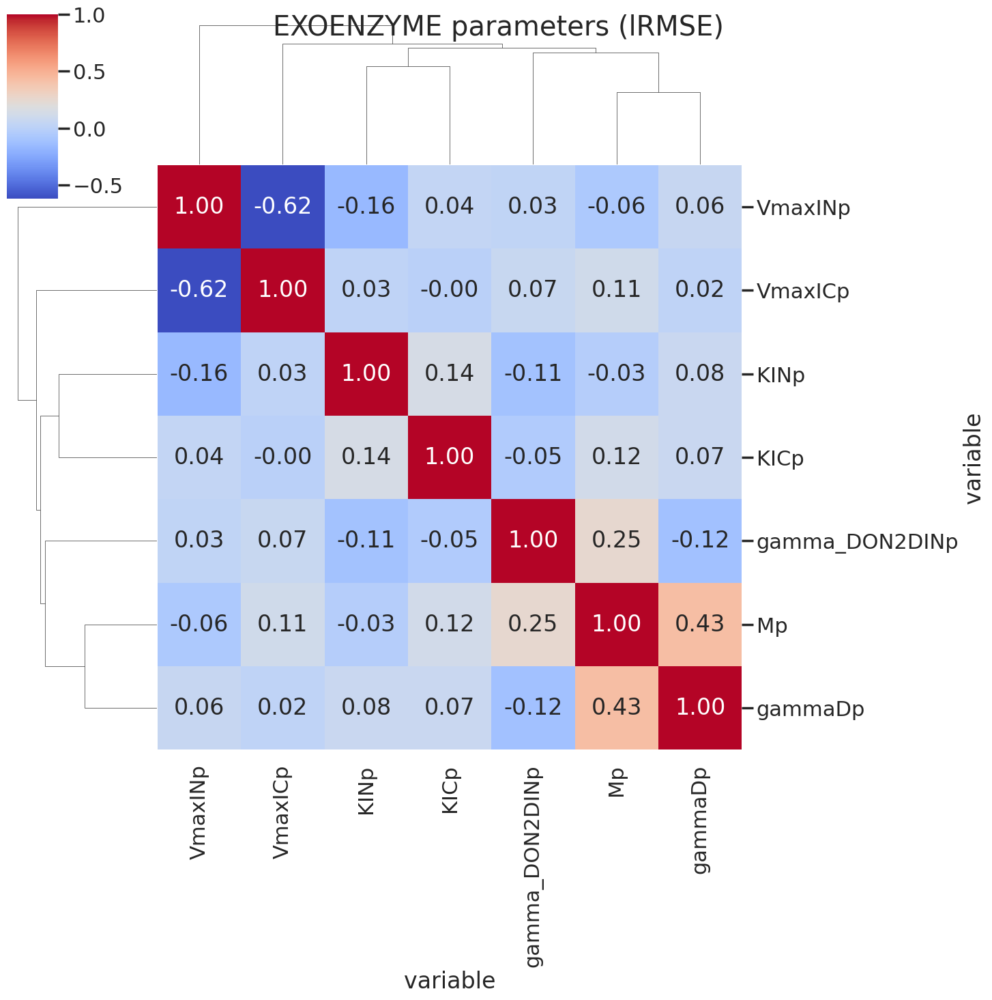

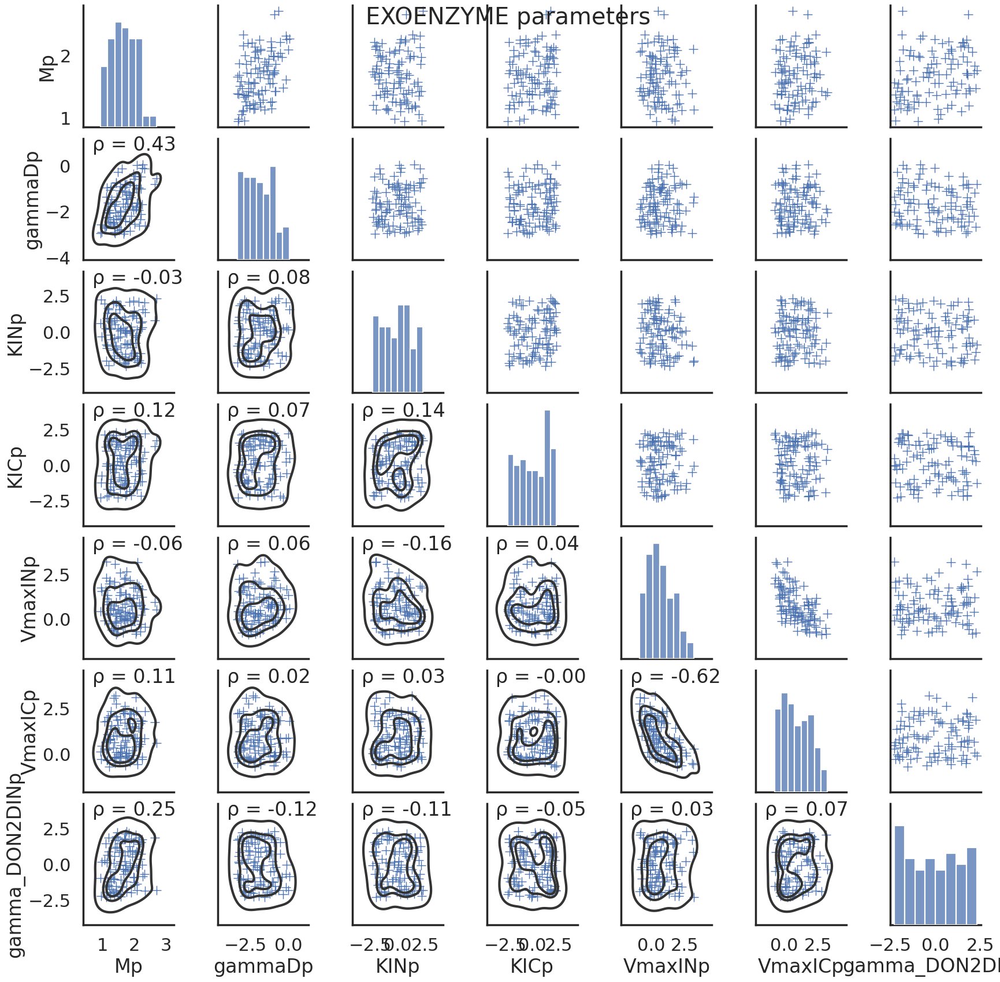

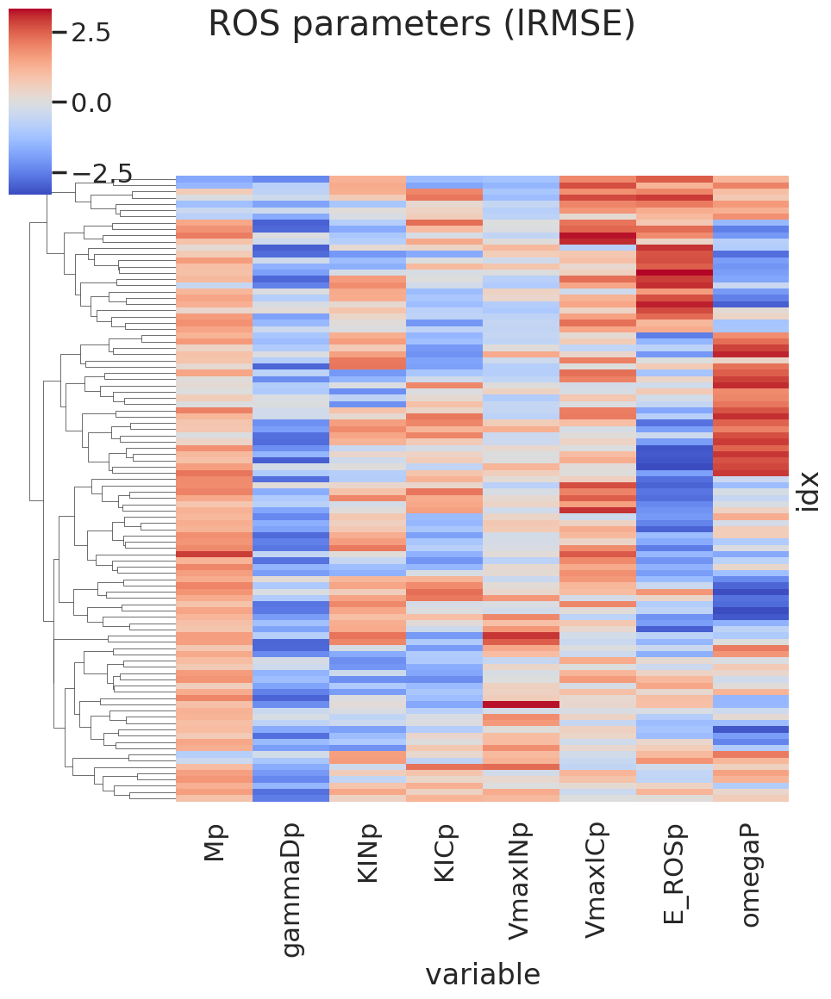

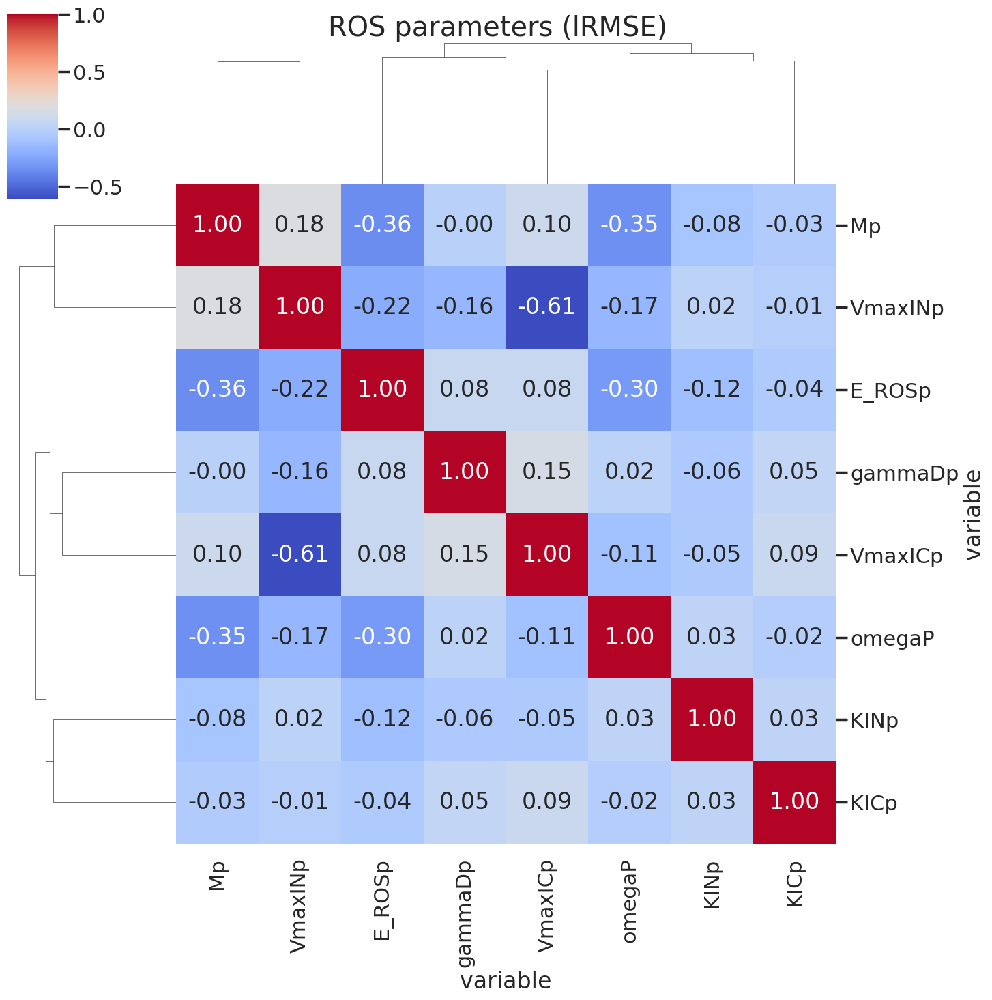

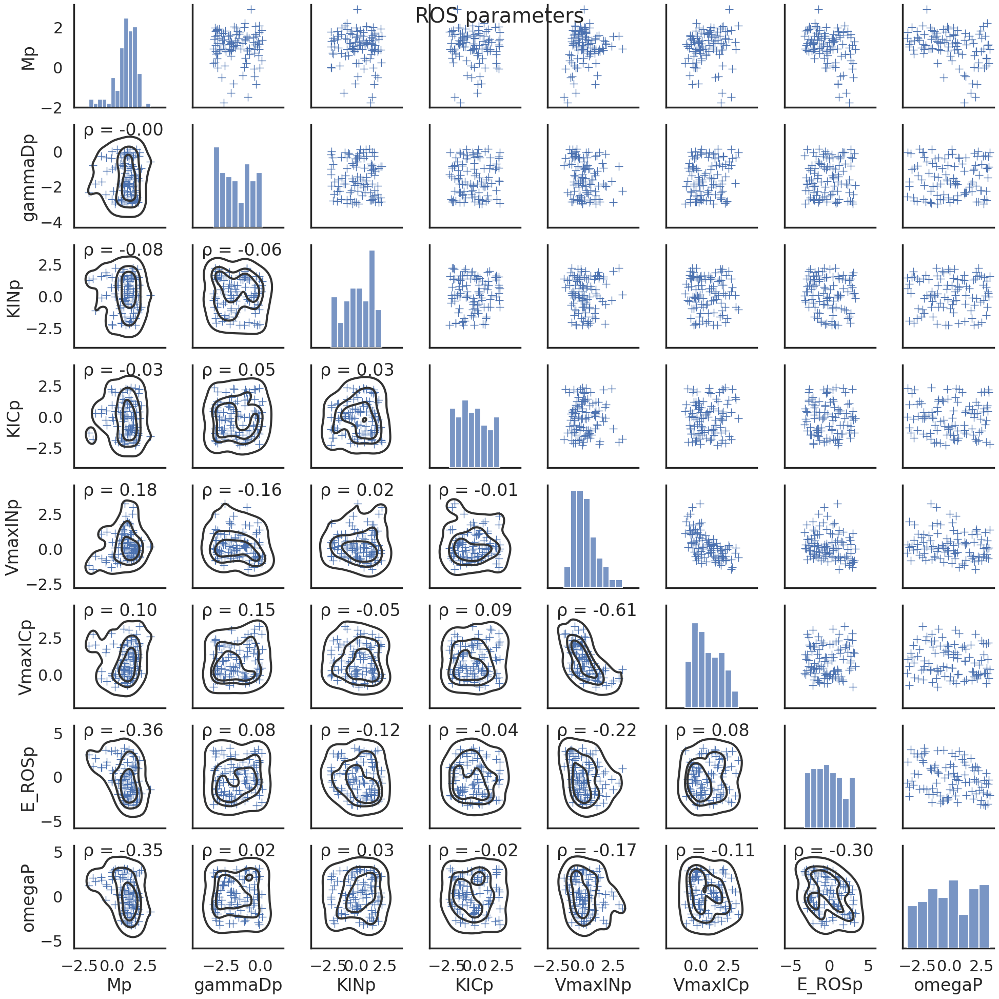

In [156]:
        sns.set_context('poster')
    
        mrows = min_rows 
        for model in morder:
            cur_params_to_update, _, _ = get_param_tuning_values(model, organism_to_tune)
            tmp = mparams_df.loc[
                mparams_df.idx.isin(mrows.idx) &
                mparams_df.model.isin([model]) &
                mparams_df.variable.isin(cur_params_to_update) 
            ].copy()
            mtmp = tmp.pivot_table(index='idx', columns='variable', values='FC')[cur_params_to_update] #fill_value=0)
            #print(l, model, mtmp.isna().sum())
            sns.clustermap(
                mtmp,
                cmap='coolwarm',
                yticklabels=False,
                figsize=(10,12),
                col_cluster=False,
            )
            plt.suptitle(f'{model} parameters ({l})')
            plt.show()

            sns.clustermap(mtmp.corr(), cmap='coolwarm', annot=True,fmt='.2f', figsize=(15,15))
            plt.suptitle(f'{model} parameters ({l})')
            plt.show()
            
            g = sns.pairplot(
                data=mtmp,
                plot_kws=dict(marker="+", linewidth=1),
            )
            g.map_lower(sns.kdeplot, levels=4, color=".2")
            g.map_lower(corrfunc)
            plt.suptitle(f'{model} parameters')
            plt.show()


In [64]:
min_rows.idx

8       shgo3_sobol_1007_EXOENZYME
80       shgo3_sobol_151_EXOENZYME
89        shgo3_sobol_15_EXOENZYME
132      shgo3_sobol_199_EXOENZYME
160      shgo3_sobol_223_EXOENZYME
                   ...            
8240           shgo4_sobol_739_ROS
8364           shgo4_sobol_876_ROS
8391           shgo4_sobol_902_ROS
8407           shgo4_sobol_917_ROS
8427            shgo4_sobol_93_ROS
Name: idx, Length: 250, dtype: object

In [238]:
final_idxes = set(min_rows.idx) 
len(final_idxes)

In [240]:
out_dpath = 'VPRO/X0'
for idx in final_idxes:
    ser_x = mparams_df.loc[mparams_df.idx.isin([idx]), ['variable', 'value']]
    ser_x.index= ser_x.variable
    actual_finalX = ser_x.value.to_dict()
    res_fpath = os.path.join(out_dpath, f'{idx}.json')
    print(res_fpath)
    params2json(actual_finalX, res_fpath)


VPRO/X0/shgo4_sobol_34_OVERFLOW.json
VPRO/X0/shgo4_sobol_725_OVERFLOW.json
VPRO/X0/shgo3_sobol_880_EXOENZYME.json
VPRO/X0/shgo4_sobol_359_ROS.json
VPRO/X0/shgo3_sobol_126_OVERFLOW.json
VPRO/X0/shgo4_sobol_340_EXOENZYME.json
VPRO/X0/shgo3_sobol_734_MIXOTROPH.json
VPRO/X0/shgo3_sobol_197_MIN.json
VPRO/X0/shgo4_sobol_192_EXOENZYME.json
VPRO/X0/shgo4_sobol_639_EXOENZYME.json
VPRO/X0/shgo3_sobol_573_MIN.json
VPRO/X0/shgo3_sobol_89_MIN.json
VPRO/X0/shgo4_sobol_94_OVERFLOW.json
VPRO/X0/shgo3_sobol_88_EXOENZYME.json
VPRO/X0/shgo3_sobol_530_OVERFLOW.json
VPRO/X0/shgo4_sobol_721_OVERFLOW.json
VPRO/X0/shgo3_sobol_768_EXOENZYME.json
VPRO/X0/shgo4_sobol_473_MIN.json
VPRO/X0/shgo4_sobol_320_MIXOTROPH.json
VPRO/X0/shgo3_sobol_575_EXOENZYME.json
VPRO/X0/shgo3_sobol_326_MIXOTROPH.json
VPRO/X0/shgo3_sobol_246_MIXOTROPH.json
VPRO/X0/shgo3_sobol_214_OVERFLOW.json
VPRO/X0/shgo4_sobol_158_MIN.json
VPRO/X0/shgo4_sobol_633_OVERFLOW.json
VPRO/X0/shgo3_sobol_490_MIXOTROPH.json
VPRO/X0/shgo3_sobol_288_EXOENZYME.

VPRO/X0/shgo4_sobol_704_MIXOTROPH.json
VPRO/X0/shgo3_sobol_641_MIXOTROPH.json
VPRO/X0/shgo4_sobol_107_ROS.json
VPRO/X0/shgo4_sobol_642_ROS.json
VPRO/X0/shgo4_sobol_707_EXOENZYME.json
VPRO/X0/shgo3_sobol_358_MIN.json
VPRO/X0/shgo4_sobol_797_ROS.json
VPRO/X0/shgo3_sobol_450_MIN.json
VPRO/X0/shgo3_sobol_107_ROS.json
VPRO/X0/shgo3_sobol_473_OVERFLOW.json
VPRO/X0/shgo4_sobol_794_MIN.json
VPRO/X0/shgo4_sobol_582_MIN.json
VPRO/X0/shgo3_sobol_358_OVERFLOW.json
VPRO/X0/shgo4_sobol_12_ROS.json
VPRO/X0/shgo4_sobol_149_ROS.json
VPRO/X0/shgo3_sobol_251_ROS.json
VPRO/X0/shgo3_sobol_432_ROS.json
VPRO/X0/shgo4_sobol_636_EXOENZYME.json
VPRO/X0/shgo3_sobol_282_MIN.json
VPRO/X0/shgo3_sobol_686_MIXOTROPH.json
VPRO/X0/shgo4_sobol_512_MIXOTROPH.json
VPRO/X0/shgo4_sobol_154_ROS.json
VPRO/X0/shgo3_sobol_113_MIXOTROPH.json
VPRO/X0/shgo4_sobol_771_MIXOTROPH.json
VPRO/X0/shgo3_sobol_71_EXOENZYME.json
VPRO/X0/shgo4_sobol_591_MIXOTROPH.json
VPRO/X0/shgo4_sobol_963_MIXOTROPH.json
VPRO/X0/shgo3_sobol_359_EXOENZYME.j

In [331]:
os.listdir()

['__pycache__',
 'model_store_ponly_find_lsq_x0.ipynb',
 'model_store_ponly.ipynb',
 'run_shgo_ponly.py',
 'tmp',
 '.ipynb_checkpoints',
 'reference_10cc_axenic.xlsx',
 'run_least_squares_het.py',
 'model_store_cc debug.ipynb',
 'VPRO',
 'run_monte.py',
 'model_equations_separate_NC_store.py',
 'Model_Parameters Store model.xlsx',
 'results',
 'run_least_squares_ponly.py',
 'reference_pro99_axenic.xlsx',
 'run_files',
 'model_param_sensitivity_ponly.ipynb',
 'reference_10cc.xlsx',
 'calc_csat.py',
 'model_store_cc.ipynb',
 'results_postprocess.py',
 'model_equations_separate_NC_store_numba.py']

In [332]:
tmprefdf = pd.read_excel( 'reference_10cc.xlsx',)
tmprefdf

,day,Sample,id,replicate,transfer,transfer day,heterotroph,full name,FL,Group,predicted,ref_Bp[N],ref_Bp[C],t
0,0.000000,10A0,10,A,0,0,HOT5_F3,Marinovum 5F3,0.061,Weak,1.453517e+06,1.297783,8.597814,0.0
1,0.000000,10B0,10,B,0,0,HOT5_F3,Marinovum 5F3,0.070,Weak,1.667971e+06,1.489259,9.866344,0.0
2,0.000000,10C0,10,C,0,0,HOT5_F3,Marinovum 5F3,0.108,Weak,2.573440e+06,2.297715,15.222359,0.0
3,0.000000,11A0,11,A,0,0,HOT5_C3,Roseovarius 5C3,0.080,Weak,1.906252e+06,1.702011,11.275821,0.0
4,0.000000,11B0,11,B,0,0,HOT5_C3,Roseovarius 5C3,0.084,Weak,2.001565e+06,1.787111,11.839612,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2215,128.767361,7B0,7,B,0,0,nitzsch,Sulfitobacter pseudonitzschiae,0.086,Sustained,2.049221e+06,1.829662,12.121508,11125500.0
2216,128.767361,7C0,7,C,0,0,nitzsch,Sulfitobacter pseudonitzschiae,0.071,Sustained,1.691799e+06,1.510535,10.007291,11125500.0
2217,128.767361,9A0,9,A,0,0,k-12,E. coli,0.040,Weak,9.531260e+05,0.851005,5.637911,11125500.0
2218,128.767361,9B0,9,B,0,0,k-12,E. coli,0.040,Weak,9.531260e+05,0.851005,5.637911,11125500.0


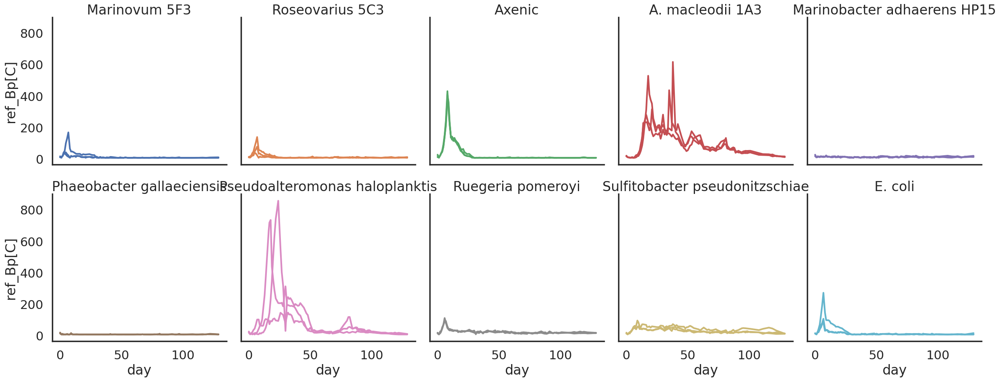

In [334]:
sns.relplot(
    data=tmprefdf,
    x='day', y='ref_Bp[C]',
    col='full name', col_wrap=5,
    kind='line', estimator=None, units='Sample', hue='full name', legend=False,
    
).set_titles(col_template='{col_name}', row_template='{row_name}')

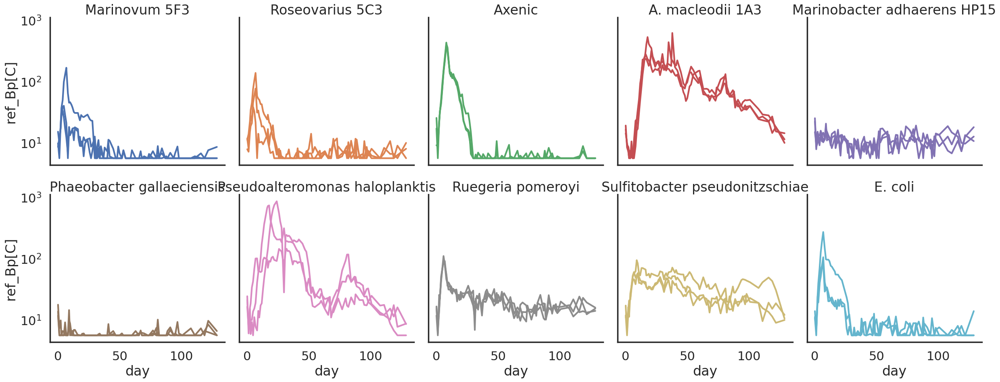

In [335]:
sns.relplot(
    data=tmprefdf,
    x='day', y='ref_Bp[C]',
    col='full name', col_wrap=5,
    kind='line', estimator=None, units='Sample', hue='full name', legend=False,
    
).set_titles(col_template='{col_name}', row_template='{row_name}').set(yscale='log')